# 3. Handcrafted Model: Baseline LeNet-5

### I. Team-Members:
- Felix Gaber, 20221385@novaims.unl.pt
- Felix Gayer, 20220320@novaims.unl.pt
- David Halder, 20220632@novaims.unl.pt
- Lukas Stark, 20220626@novaims.unl.pt
- Rita Soares, 20220616@novaims.unl.pt


### II. Link to the Dataset:
https://drive.google.com/drive/folders/1D8Hd49L0OLlSz2oCuuctfCKDcR8HK_c4?usp=share_link


###III. Summary of the notebook:
#### III a. Model development process



In the following Notebook a sequential model is defined, based on a version of the ``LeNet-5``. This baseline model defines the foundation for the following models.

During the creation of the handcrafted model, the recommended steps outlined by *Goodfellow, Bengio, and Courville* (2018, p. 416 pp.)[1] are adhered to:

- **Determine your goals — what error metric to use, and your target value for this error metric. These goals and error metrics should be driven by the problem that the application is intended to solve**
 - For this example, a high ``accuracy`` is the most reasonable choise since the tires should only be exchanged when they are indeed showing sign of wear. Changing them prior, would be  economically and ecologically inefficient. However, not changing them in time also bears risk of accidents or supply chain breakdowns. Thus, the main performance metric of this project is ``Accuracy``

- **Establish a working end-to-end pipeline as soon as possible, including the  estimation of the appropriate performance metrics.**
 - Taking into consideration the different trials and experiments, the goal for the final test performance is set to **80%**

- **Instrument the system well to determine bottlenecks in performance. Diagnose which components are performing worse than expected and whether poor performance is due to overfitting, underfitting, or a defect in the data or software.**
 - The analysis of the developed models is also explained in detail during the various experiments conducted

- **Repeatedly make incremental changes such as gathering new data, adjusting hyperparameters, or changing algorithms, based on specific findings from your instrumentation.**
 - The steps taken to build and tune the models are justified along their development.

The notebook is structured according to this procedure.

# References 

1. Goodfellow, Ian; Bengio, Yoshua; Courville, Aaron (2018): Deep learning.
2. Keras (2023): Keras documentation: ModelCheckpoint. Available online at https://keras.io/api/callbacks/model_checkpoint/, updated on 3/25/2023, checked on 4/6/2023.
3. Chollet, François (2018): Deep learning with Python. Shelter Island, NY: Manning.
4. Ioffe, Sergey; Szegedy, Christian (2015): Batch Normalization: Accelerating Deep Network Training by Reducing Internal Covariate Shift. Available at https://arxiv.org/abs/1502.03167.
5. Girshick, R., et al. (2014): Rich feature hierarchies for accurate object detection and semantic segmentation, CVPR 2014.
6. Srivastava, N., et al. (2014): Dropout: a simple way to protect neural networks from overfitting, JMLR 2014.
7. LeCun, Y., et al. (1998): Gradient-based learning applied to document recognition, Proc. IEEE 1998.
Glorot, Xavier;
8. Howard, Andrew, et al. (2018): Searching for MobileNetV3. Available at https://arxiv.org/abs/1905.02244.
9. Huang, G. B., & Ling, C. X. (2005): Using AUC and accuracy in evaluating learning algorithms, IEEE Transactions on Knowledge and Data Engineering.
10. Buda, M., Maki, A., & Mazurowski, M. A. (2018): A systematic study of the class imbalance problem in convolutional neural networks, Neural Networks, 106, 249-259. doi:10.1016/j.neunet.2018.07.011.
11. Chawla, N. V., Bowyer, K. W., Hall, L. O., & Kegelmeyer, W. P. (2002): SMOTE: Synthetic minority over-sampling technique, Journal of Artificial Intelligence Research, 16, 321-357. doi:10.1613/jair.953.
12. Bengio, Yoshua, et al. (2012): Practical recommendations for gradient-based training of deep architectures. Available at https://arxiv.org/abs/1206.5533.
13. Bengio, Yoshua (2010): Understanding the difficulty of training deep feedforward neural networks. AISTATS 2010.
14. Keras (2023): Keras documentation: EarlyStopping. Available online at https://keras.io/api/callbacks/early_stopping/, updated on 3/25/2023, checked on 4/6/2023.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

%cd '/content/drive/MyDrive/DeepLearningProject/03 Project'

Mounted at /content/drive
/content/drive/.shortcut-targets-by-id/1_93ad1t8CGrSTc3bgngEEjuCVXLB6eHY/03 Project


---

## 3.1 Import needed Libraries

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os

import tensorflow as tf
from tensorflow.keras import Sequential, layers, initializers, regularizers, optimizers, metrics

import logging
logging.getLogger('tensorflow').disabled = True
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

from keras import regularizers
from keras.layers import Dropout, BatchNormalization

from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.layers import Dropout
from tensorflow.keras.preprocessing import image_dataset_from_directory
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import confusion_matrix
import seaborn as sns
from datetime import datetime
import cv2
import pickle


---

## 3.2 Import, Pre-process and split data

In [ ]:
# Set the machine
gdrive = True

# Set the connection string
path = '/content/drive/MyDrive/DeepLearningProject/03 Project/Data/'
main_folder, training_folder, testing_folder = "Tire Textures/", "training_data/", "testing_data/"

In [ ]:
#Set dataset parameters
image_size = (224, 224)
crop_to_aspect_ratio = True
color_mode = 'rgb' 
batch_size = 32
label_mode = 'binary'
validation_split = 0.2
shuffle = True
seed = 42

# Defines input shape from image size
input_shape = (*image_size, 1 if color_mode=='grayscale' else 3)

In [ ]:
# Generate training and validation datasets directly from directory
path = '/content/drive/MyDrive/DeepLearningProject/03 Project/Data/'
ds_train, ds_val = image_dataset_from_directory(
    directory=path + main_folder + training_folder,
    image_size=image_size,
    crop_to_aspect_ratio=crop_to_aspect_ratio,
    color_mode=color_mode,
    batch_size=batch_size,
    label_mode=label_mode,
    subset='both',
    validation_split=validation_split,
    shuffle=shuffle,
    seed=seed
)

# Check object properties
print("\nObject's type:\t", type(ds_train))
print("Is it a tf.data.Dataset?\t R:", isinstance(ds_train, tf.data.Dataset))
print("Classes:", ds_train.class_names)

Found 703 files belonging to 2 classes.
Using 563 files for training.
Using 140 files for validation.

Object's type:	 <class 'tensorflow.python.data.ops.batch_op._BatchDataset'>
Is it a tf.data.Dataset?	 R: True
Classes: ['cracked', 'normal']


In [ ]:
ds_test = image_dataset_from_directory(path + main_folder + testing_folder, 
                                       image_size=image_size,
                                       crop_to_aspect_ratio=crop_to_aspect_ratio,
                                       color_mode=color_mode,
                                       batch_size=batch_size,
                                       label_mode=label_mode,                                     
                                       shuffle=shuffle,
                                       seed=seed)


labels_test = np.concatenate([y for x, y in ds_test], axis=0)

Found 335 files belonging to 2 classes.


## 3.2 Preprocessing and Data Augmentation Pipeline 

In [ ]:
#@title Preprocessing Pipeline
data_normalization = Sequential([
    layers.Rescaling(1/255)
    ], name='normalization_pipeline')

In [ ]:

data_augmentation = Sequential([
    #layers.RandomFlip(), 
    #layers.RandomRotation(factor=0.1), 
    layers.RandomZoom(height_factor=0.1, width_factor=0.1),
    layers.RandomContrast(factor=0.25),
    layers.RandomBrightness(factor=0.2),
    #layers.RandomTranslation(height_factor=(-0.1, 0.1), width_factor=(-0.1, 0.1))
    ], name='augmentation_pipeline')

---
## 3.3 Functions

In [ ]:
#@title 3.3.1 *Function:* Plot Accuracy & Loss Curves
model_name = 'missing'
def plot_curves(model_fit=None, model_name=model_name):
  if model_fit == None:
    df_hist = pd.read_csv(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}_hist.csv')
  else:
    # Create DataFrame object
    df_hist = pd.DataFrame.from_dict(model_fit.history)
    df_hist['Epoch'] = np.arange(1, len(df_hist) + 1, 1)
    df_hist['accuracy_difference'] = round(df_hist.accuracy - df_hist.val_accuracy, 2)
    # save results dataframe as csv
    # df_hist.to_csv(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}_hist.csv', index=False)

  fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(8, 8))

  # Plot accuracy and validation accuracy
  axs[0].plot(df_hist['Epoch'], df_hist['accuracy'], label='Training Accuracy')
  axs[0].plot(df_hist['Epoch'], df_hist['val_accuracy'], label='Validation Accuracy')
  axs[0].set_xlabel('Epoch')
  axs[0].set_ylabel('Accuracy')
  axs[0].legend(loc='upper left')

  # Plot loss and validation loss
  axs[1].plot(df_hist['Epoch'], df_hist['loss'], label='Training Loss')
  axs[1].plot(df_hist['Epoch'], df_hist['val_loss'], label='Validation Loss')
  axs[1].set_xlabel('Epoch')
  axs[1].set_ylabel('Loss')
  axs[1].legend(loc='lower left')

  # Display final 5 results
  display(df_hist[['Epoch', 'accuracy', 'val_accuracy', 'accuracy_difference']].tail(5))
  print('\n','\n')

  # Show the plot
  plt.show()

In [ ]:
#@title 3.3.2 *Functions*: Plot wrongly identified pictures, ROC-AUC & Classification Matrix
def load_images(folder):
    
    imgsx = []
    target = 1  #cracked = 1, normal = 0
    labels = []
    for i in os.listdir(folder):
        subdir = os.path.join(folder, i)
        for j in os.listdir(subdir):
            img_dir = os.path.join(subdir,j)
            
            img = cv2.imread(img_dir)
            img = cv2.resize(img, (224,224))
            imgsx.append(img)
            labels.append(target)

        target -= 1
    
    imgsx = np.array(imgsx)
    labels = np.array(labels)
    
    return imgsx, labels

def load_only_images(paths):
  
  imgsx = []
  for i in paths: 
    #print(i)
    img = cv2.imread(i)
    img = cv2.resize(img, (224,224))
    imgsx.append(img)
  imgsx = np.array(imgsx)
  return imgsx



def get_false_data(test_data, test_labels, predictions):

  false_data = []
  for i in range(len(test_labels)):
    x = []
    if test_labels[i] != predictions[i]:
      x.append(test_data[i])
      x.append(test_labels[i])
      x.append(predictions[i])
      false_data.append(x)

  return false_data




def plot_images(data):
    plt.figure(figsize=(22,8))
    for i in range(10):
        axs = plt.subplot(2,5, i+1)
        idx = np.random.randint(0, len(data))
        plt.imshow(data[idx][0], cmap = 'gray')
        plt.axis('on')
        axs.set_xticklabels([])
        axs.set_yticklabels([])
        axs.title.set_text('label: ' + str(data[idx][1]) + '  prediction: ' + str(data[idx][2]))
        plt.subplots_adjust(wspace=None, hspace=None)


def plot_auc(predictions, test_labels):
  
  fpr, tpr, thresholds = roc_curve(predictions, test_labels)
  auc = roc_auc_score(predictions, test_labels)

  fig, ax = plt.subplots()
  ax.plot(fpr, tpr)
  ax.plot([0, 1], [0, 1], color='navy', linestyle='--', label='random')
  plt.title(f'AUC: {auc}')
  ax.set_xlabel('False positive rate')
  ax.set_ylabel('True positive rate')



def plot_cm(predictions, labels , p=0.5):
  cm = confusion_matrix(labels, predictions > p)
  plt.figure(figsize=(5,5))
  sns.heatmap(cm, annot=True, fmt="d")
  plt.title('Confusion matrix @{:.2f}'.format(p))
  plt.ylabel('Actual label')
  plt.xlabel('Predicted label')

  print('True Negatives: ', cm[0][0])
  print('False Positives: ', cm[0][1])
  print('False Negatives: ', cm[1][0])
  print('True Positives: ', cm[1][1])
  print('Total Positive Images: ', np.sum(cm[1]))

  
def viz_trial_results( model, dataset_val):
  #Curves
  #plot_curves(model_name = model_name)
  #Predict Values (add model)
  predictions_val= model.predict(dataset_val)

  #Predicted classes 
  prediction_classes_val = np.concatenate((predictions_val > p).astype("int32"), axis=0 )
  #False Data
  false_data = get_false_data(val_data, labels_val, prediction_classes_val)

  plot_auc(labels_val, predictions_val)
  plot_cm(prediction_classes_val, labels_val , p)
  plot_images(false_data)


## 3.4 Iterative Model Development


Before the model development, labels and images need to be extracted for the visualisation of the results of the respective trial. 

Furthermore, two callbacks are defined:
  - ``Early Stopping``: Stop training when a monitored metric has stopped improving. In this the validation loss is used as the stopping metric since it represents a more robust metric than the validation accuracy for early stopping, since it measures the quality of the model's predictions in terms of the sum of the errors between the predicted values and the actual values.  This callback is essential, especially in terms of **efficiency**, since it allows its users to define a very high number of epochs but still stop the training as soon as the performance does not improve anymore. The ``patience`` is set to five epochs, so that the model does not stop immediately when no improvement can be seen. Furthermore, the argument ``restore_best_weights = True`` ensures that if the model is stopped, the best weights are used for the prediction. *(see Keras, 2023) [13]*
  - ``ModelCheckpoint``: this callback saves the best model and its weights, in terms of a specified metric. In this case the ``validation_accuraccy`` is used, due to the same reasons why ``accuraccy`` was chosen as the error metric.(See Keras, 2023)[2]


In [ ]:
#Preperation for the visualisation of the results 

#Validation labels
labels_val = np.concatenate([y for x, y in ds_val], axis=0)

#filepaths to the validation set
val_file_paths = ds_val.file_paths

#Get validation images
val_data=load_only_images(val_file_paths)

#Treshold
p=0.5

In [ ]:
#Define the Run?
#"teacher"
run_type = "student"

early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True, 
    verbose=1
)

now = datetime.now()
dt_string = now.strftime("%Y-%m-%d")



checkpoint = ModelCheckpoint(
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)

### 3.4.2 LeNet-5 V.1 (Baseline)

**The development process is as follows:** 
  1. Defining a simple baseline model B
  2. Reasonably identifying an architectural component to improve upon the baseline model
  3. Extending the baseline model E
  4. Performing a fair comparison between B and E on the underlying problem, and
identifying which generalizes better
  5. repeat

As our baseline model a altered version of the ``LeNet-5``, is used. The subsampling layers, are replaced by pooling layers in this example. (see Figure 1)

According to Chollet (2018, p.113)[4], three key choices need to be made to build the baseline model:
- **Last Layer Activation**: Since this project faces a binary classification problem, the ``sigmoid`` activation is chosen.
- **Loss Function**: Likewise, the problem at hand defines the loss function, ``binary_crossentropy``
- **Optimization Configuration**: The first optimizer used is the **Adaptive Moment Estimation (Adam**), with the standard learning rate of ``0.001``. Both can be changed later to assess the respective impact on the classification accuracy. 


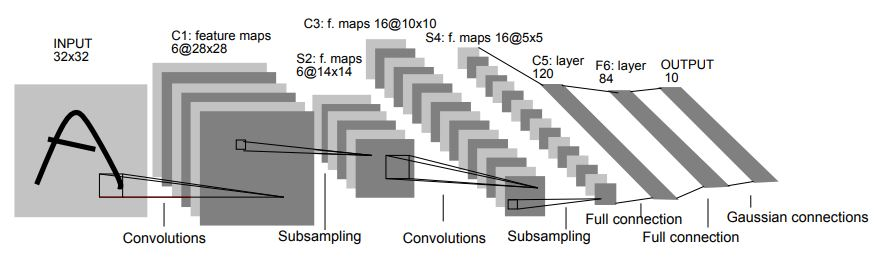

Figure 1: Architecture of LeNet-5

#### 3.4.2.1 Baseline Architecture

**Input and normalization**
- The first layer in the model is the ``input_layer``, which receives the shape of the input images and the RGB channels. In this case, 224, 224, 3, since colored pictures are used for training the model.

- Next, the previously described normalization layer is implemented, which performs image scaling down to [0, 1].

**Feature Detection**

In the feature detection layer of the model, features are detected in the input images. This is achieved by applying filters to the input image:

- The first layer of this type is a ``Conv2D`` layer with 6 filters of size 5x5. The 5x5 size refers to the width and height of each filter. Each filter has a depth of 3 since the input images have 3 RGB channels. Therefore, this layer has 76 trainable parameters per filter (5x5x3 + 1 bias), resulting in 456 trainable parameters. The number of filters in this layer is 6, which means it detects six features on the input layer. The number of trainable parameters in a layer is important because it affects how well the model is trained and how fast it learns. The ``ReLU`` activation function is used in the model's hidden layers. The rectified linear unit is a piecewise linear function that outputs the input directly if positive and zero otherwise. This function is computationally efficient and has been shown to improve the training due to, among other factors, avoiding the vanishing gradient problem. 

- The next layer is an ``AveragePooling2D`` layer. This layer reduces the size of the feature maps output from the previous layer by computing the average value over a sliding window of size 2x2. In comparison, max-pooling uses the maximum value within the sliding window instead of the average value. The size of the sliding window is also called the pool size. The stride (step size) of 2 means that the window is moved 2 pixels as it moves to the next position. Therefore, the output of this layer is a reduced feature map that is half the size of the original feature map.

- The next ``Conv2D`` layer has 16 filters of size 5x5. Again, the filters have a depth of 3. Therefore, there are a total of 2416 trainable parameters in this layer. The number of filters has been increased to detect more features in the input images than the first ``Conv2D``layer.

- The following ``AveragePooling2D`` layer again has a pool size of 2x2 and stride of 2.

- Finally, there is the ``Flatten`` layer, which converts the 2D feature maps into a 1D array to feed the next layer in the model.

**Classification**

In the ``LeNet-5_V1`` model, there are three layers involved in classification:

-	The first ``Dense`` layer has 44,944 x 120 units, resulting in 5,392,280 trainable parameters. This layer takes the 1D array from the Flatten layer and applies a fully connected layer with 120 neurons. This layer aims to learn a high-level representation of the input features.

-	The second Dense layer has 120 x 84 = 10,080 trainable parameters. It also applies a fully connected layer with 84 neurons to further refine the features learned in the first layer.

-	Finally, the output layer has 84 x 1 = 84 trainable parameters. It uses the sigmoid activation function, which squeezes the output values between 0 and 1, representing the probability that the input image belongs to a certain class. This layer provides the final classification output for the model.

Therefore, the total trainable parameters in the LeNet-5_V1 model is 456 + 2,416 + 5,392,200 + 10,164 + 85 = 5,406,321.


In [ ]:
model_name ="LeNet-5_V1"

lenet_1 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu'),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu'),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers
    layers.Dense(units=120, activation='relu'),
    layers.Dense(units=84, activation='relu'),
    # Output layer
    layers.Dense(1, activation="sigmoid")
    ], name=model_name)

lenet_1.summary()

Model: "LeNet-5_V1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 average_pooling2d (AverageP  (None, 110, 110, 6)      0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 53, 53, 16)       0         
 ePooling2D)                                                     
                                                        

Epoch 1/100
18/18 [==============================] - ETA: 0s - loss: 0.8108 - accuracy: 0.5471
Epoch 1: val_accuracy improved from -inf to 0.54286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/LeNet-5_V1.h5
18/18 [==============================] - 78s 2s/step - loss: 0.8108 - accuracy: 0.5471 - val_loss: 0.6967 - val_accuracy: 0.5429
Epoch 2/100
16/18 [=========================>....] - ETA: 0s - loss: 0.6607 - accuracy: 0.6270
Epoch 2: val_accuracy improved from 0.54286 to 0.65714, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/LeNet-5_V1.h5
18/18 [==============================] - 14s 552ms/step - loss: 0.6538 - accuracy: 0.6394 - val_loss: 0.6533 - val_accuracy: 0.6571
Epoch 3/100
16/18 [=========================>....] - ETA: 0s - loss: 0.6412 - accuracy: 0.6543
Epoch 3: val_accuracy improved from 0.65714 to 0.68571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Proje

,Epoch,accuracy,val_accuracy,accuracy_difference
3,4,0.742451,0.614286,0.13
4,5,0.795737,0.642857,0.15
5,6,0.849023,0.614286,0.23
6,7,0.882771,0.621429,0.26
7,8,0.916519,0.614286,0.30


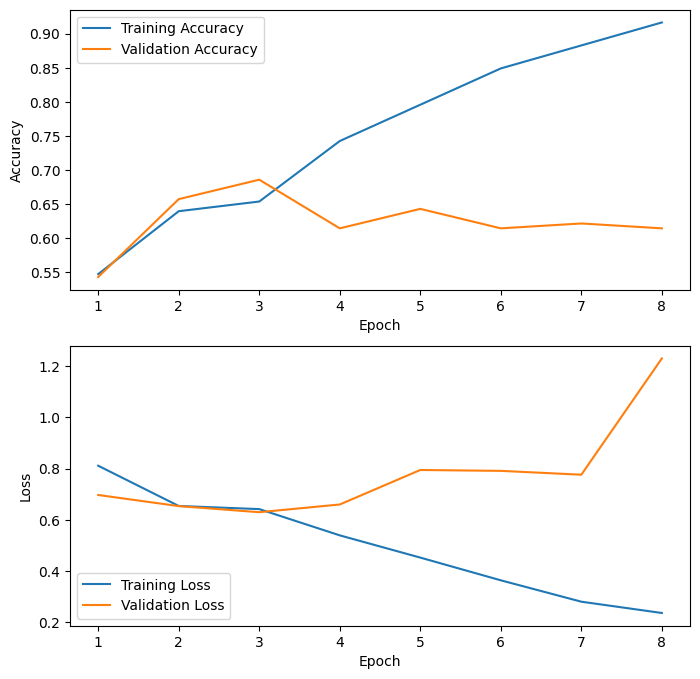

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

# Compile Model
lenet_1.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
lenet_1_fitted = lenet_1.fit(
    ds_train,
    validation_data = ds_val,
    epochs = 100,
    verbose=1,
    callbacks=[early_stopping, checkpoint])

#Save and visualise the learning curves
plot_curves(model_fit = lenet_1_fitted, model_name = model_name)


5/5 [==============================] - 3s 494ms/step
True Negatives:  33
False Positives:  31
False Negatives:  13
True Positives:  63
Total Positive Images:  76


,Epoch,accuracy,val_accuracy,accuracy_difference
3,4,0.742451,0.614286,0.13
4,5,0.795737,0.642857,0.15
5,6,0.849023,0.614286,0.23
6,7,0.882771,0.621429,0.26
7,8,0.916519,0.614286,0.30


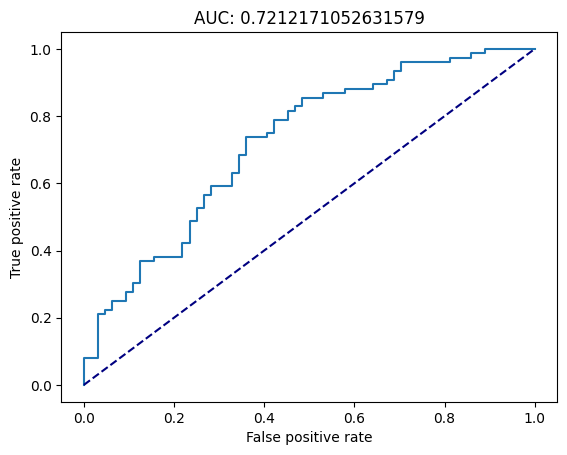

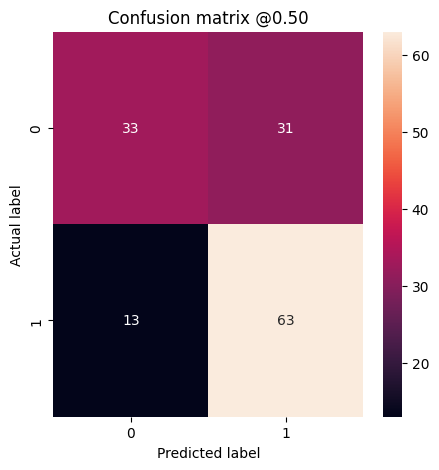

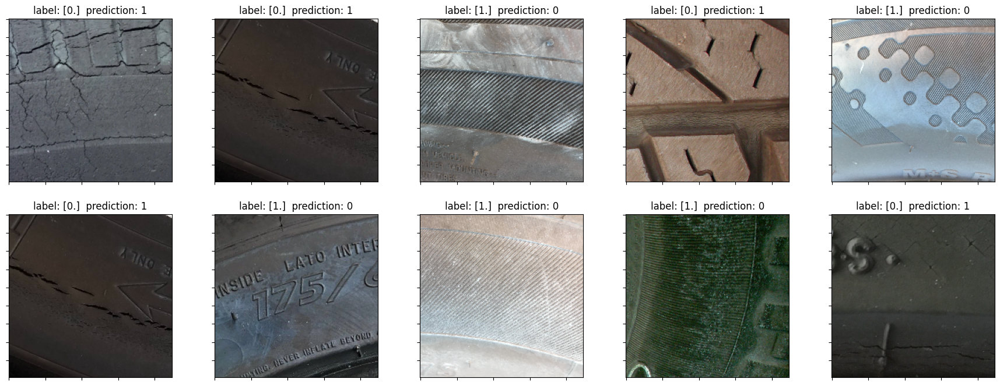

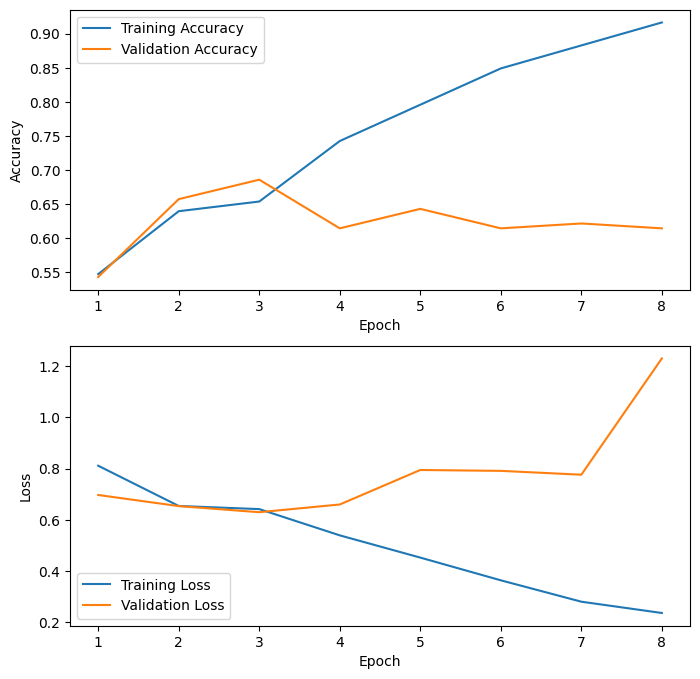

In [ ]:

lenet_1.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')

viz_trial_results(lenet_1, ds_val)

#Plot curves with data from google_drive:
plot_curves(model_fit = None, model_name = model_name)

#### 3.4.2.2 Takeaways from LeNet-5_V1

It can be seen that the model is heavily overfitting on the training set (training accuracy ``0.97`` vs validation accuraccy	``0.65``). That means, that the model is very good in predicting the images which were used for training it, but lacks the ability to generalize. In other words, the performance on unseen data has a lot of room for improvement.

It can be seen that most of the wrongfully classified images were false positives, which means that cracked tires were not identified. By visually analysing the wrongfully identified tires no clear pattern can be seen.

Analysing the learning curves it can be seen that the validataion accuracy and the validation loss is performing better at times than the training accuracy or the loss which seems highly unusual, since the model already knows the training data, as it used it for training-purposed. That could be due to the rather small validation set. As the model is not fit to the training data, yet it may occur that the validation accuracy is higher than the training accuracy.

Francois Chollet (2018, p.114 p.) [4] concludes that if a model does overfit the next steps made, are to ensure that the model is sitting right at the border between over- and undercapacity. As this border was now crossed, there are several steps that can be taken to regularize the model:


**Regularization Techniques:**

1.   Data Augmentation
2.   Dropout layers
3.   Early Stopping
4.   L1 and L2 Regularization
5. Hyperparameters
6. Add and remove layers


---


The different Hyperparameters will be closely explained before the Hyperparameter tuning. In the next steps, the measure taken will be explained and justified and analysed after application.


### 3.4.3 Handcrafted Model Vers_1 (HCM_V1)

(b) Step: Reasonably identify an architectural component to improve upon the baseline model


Since a lot of overfitting could be seen, it is first tried to reduce this by adding a l2-kernel regularization to the dense layers of the model. Regularization Methods, like the L1 or L2 regularization, reduce the model complexity, thus can be used to reduce overfitting. Weight decay coefficients can be used on convolutional layers as well as on dense fully connected layers. (See Goodfellow et al, 2018, p. 426) [1]. 

Step 1: 
Try with kernel l2 regularization with a value of 0.02 for both fully connected layers.



In [ ]:
model_name ="HCM_V1"


HCM_V1 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers

    #Add kernel regularizers to reduce overfitting
    layers.Dense(units=120, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.Dense(units=84, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V1.summary()

Model: "HCM_V1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 average_pooling2d (AverageP  (None, 110, 110, 6)      0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 53, 53, 16)       0         
 ePooling2D)                                                     
                                                            

Epoch 1/100
16/18 [=========================>....] - ETA: 0s - loss: 4.8138 - accuracy: 0.4609
Epoch 1: val_accuracy did not improve from 0.68571
18/18 [==============================] - 14s 378ms/step - loss: 4.6842 - accuracy: 0.4600 - val_loss: 3.3026 - val_accuracy: 0.5429
Epoch 2/100
18/18 [==============================] - ETA: 0s - loss: 2.8148 - accuracy: 0.5382
Epoch 2: val_accuracy did not improve from 0.68571
18/18 [==============================] - 12s 433ms/step - loss: 2.8148 - accuracy: 0.5382 - val_loss: 2.3656 - val_accuracy: 0.5429
Epoch 3/100
18/18 [==============================] - ETA: 0s - loss: 2.1152 - accuracy: 0.5329
Epoch 3: val_accuracy did not improve from 0.68571
18/18 [==============================] - 12s 486ms/step - loss: 2.1152 - accuracy: 0.5329 - val_loss: 1.8748 - val_accuracy: 0.5429
Epoch 4/100
16/18 [=========================>....] - ETA: 0s - loss: 1.7389 - accuracy: 0.5273
Epoch 4: val_accuracy did not improve from 0.68571
18/18 [=============

,Epoch,accuracy,val_accuracy,accuracy_difference
38,39,0.717584,0.592857,0.12
39,40,0.703375,0.607143,0.10
40,41,0.701599,0.571429,0.13
41,42,0.642984,0.578571,0.06
42,43,0.689165,0.557143,0.13


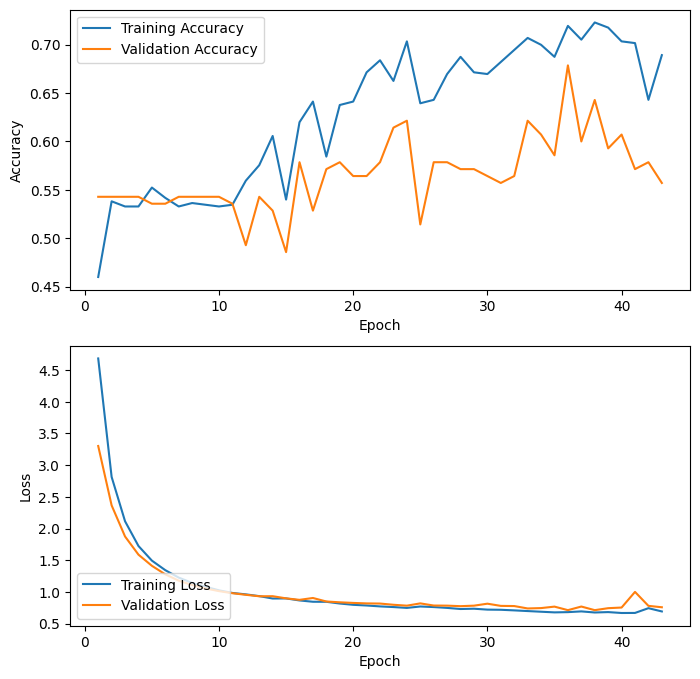

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

# Compile Model
HCM_V1.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
HCM_V1_fitted = HCM_V1.fit(
    ds_train,
    validation_data = ds_val,
    epochs = 100,
    verbose=1,
    callbacks=[early_stopping, checkpoint])

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V1_fitted, model_name = model_name)

5/5 [==============================] - 5s 777ms/step
True Negatives:  43
False Positives:  21
False Negatives:  29
True Positives:  47
Total Positive Images:  76


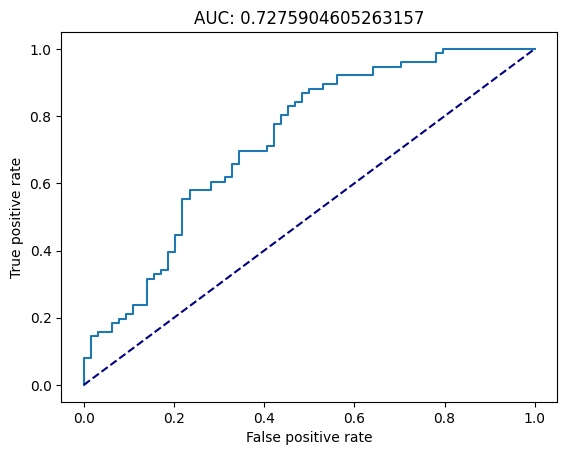

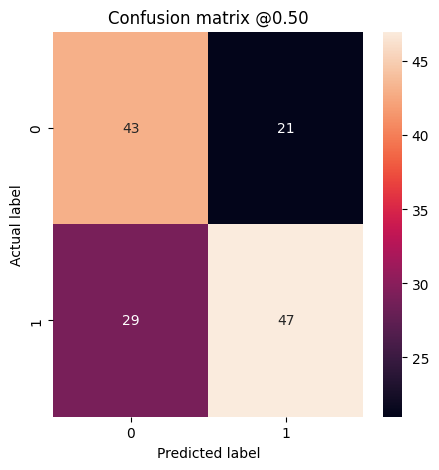

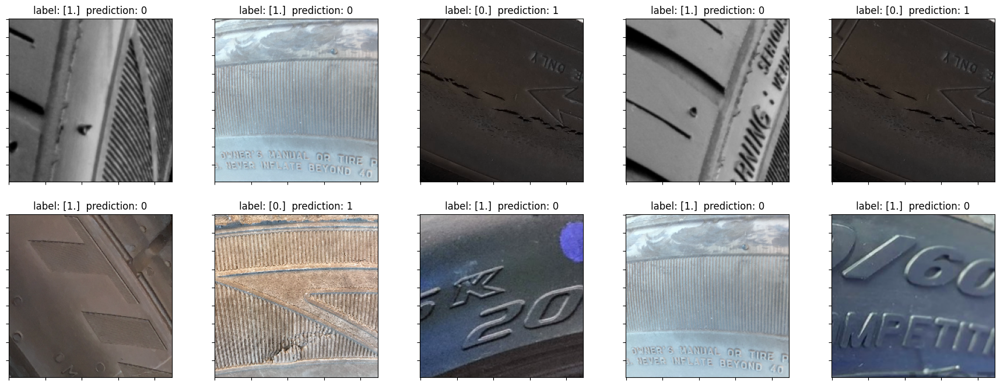

In [ ]:
#No new weights
#HCM_V1.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')

viz_trial_results(HCM_V1, ds_val)

#Plot curves with data from google_drive:
plot_curves(model_fit = None, model_name = model_name)

The kernel-regularization did increase the generalisation ability of the model, the overfitting is not as pronounced as it was before. However, in the end there is still some overfitting and the overall performance in terms of validation accuracy was lower, than in the previous architecture. 

For now the kernel-regularisation will stay implemented within the architecture and the effect on the performance will be assessed in combination with other methods.

### 3.4.4 Handcrafted Model Vers_2


The next step to increase the generalisation ability would be to add data augmentation layers. As explored earlier in the data_preprocessing, there are some augmentation steps which can make sense for this project. For now the following steps are implemented: 
-  RandomZoom(height_factor=0.1, width_factor=0.1), 
- RandomContrast(factor=0.25), 
- RandomBrightness(factor=0.2) 

In [ ]:
model_name ="HCM_V2"

HCM_V2 = Sequential([
    # Data augmentation pipeline
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # Data augmentation pipeline
    data_augmentation,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers
    layers.Dense(units=120, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.Dense(units=84, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V2.summary()

Model: "HCM_V2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 augmentation_pipeline (Sequ  (None, 224, 224, 3)      0         
 ential)                                                         
                                                                 
 conv2d_12 (Conv2D)          (None, 220, 220, 6)       456       
                                                                 
 average_pooling2d_12 (Avera  (None, 110, 110, 6)      0         
 gePooling2D)                                                    
                                                                 
 conv2d_13 (Conv2D)          (None, 106, 106, 16)      2416      
                                                            

Epoch 1/100
18/18 [==============================] - ETA: 0s - loss: 2.7878 - accuracy: 0.4352
Epoch 1: val_accuracy improved from -inf to 0.45714, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V2.h5
18/18 [==============================] - 15s 484ms/step - loss: 2.7878 - accuracy: 0.4352 - val_loss: 0.9034 - val_accuracy: 0.4571
Epoch 2/100
17/18 [===========================>..] - ETA: 0s - loss: 0.9387 - accuracy: 0.4540
Epoch 2: val_accuracy improved from 0.45714 to 0.47143, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V2.h5
18/18 [==============================] - 13s 548ms/step - loss: 0.9384 - accuracy: 0.4547 - val_loss: 0.9160 - val_accuracy: 0.4714
Epoch 3/100
18/18 [==============================] - ETA: 0s - loss: 0.9194 - accuracy: 0.4831
Epoch 3: val_accuracy did not improve from 0.47143
18/18 [==============================] - 13s 510ms/step - loss: 0.9194 - accu

,Epoch,accuracy,val_accuracy,accuracy_difference
95,96,0.53286,0.542857,-0.01
96,97,0.53286,0.542857,-0.01
97,98,0.53286,0.542857,-0.01
98,99,0.53286,0.542857,-0.01
99,100,0.53286,0.542857,-0.01


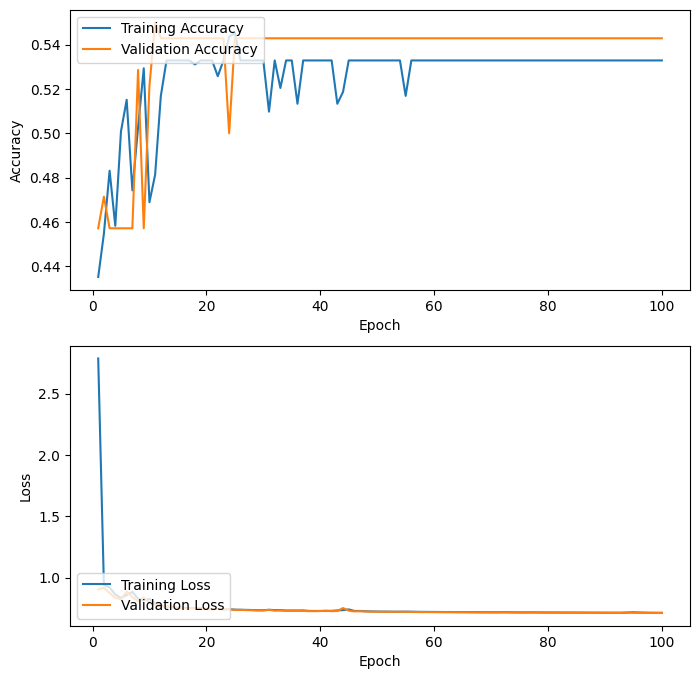

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v2 = ModelCheckpoint(
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V2.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
print(model_name)
HCM_V2_fitted = HCM_V2.fit(
    ds_train,
    validation_data = ds_val,
    epochs = 100,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v2])

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V2_fitted, model_name = model_name)

5/5 [==============================] - 4s 633ms/step
True Negatives:  1
False Positives:  63
False Negatives:  0
True Positives:  76
Total Positive Images:  76


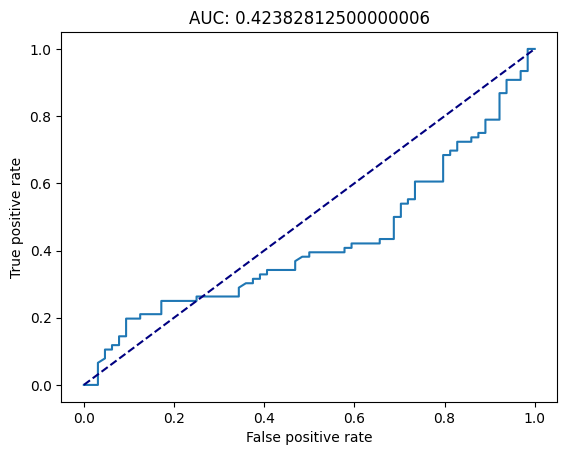

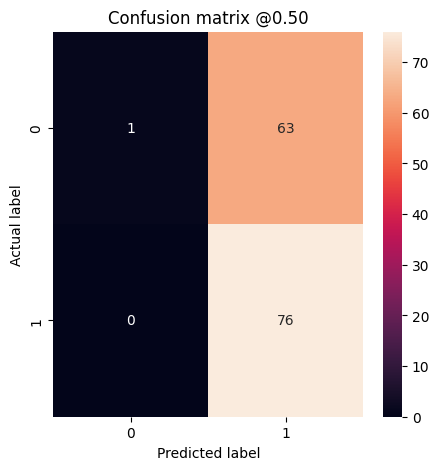

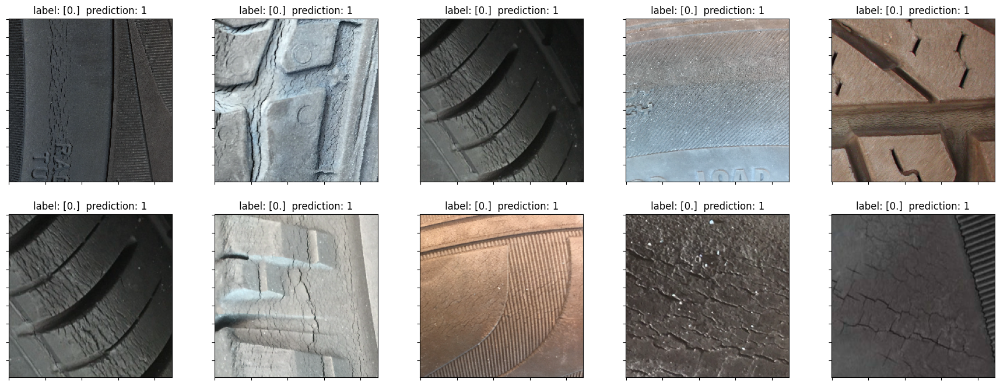

In [ ]:
HCM_V2.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V2, ds_val)

#Plot curves with data from google_drive:
plot_curves(model_fit = None, model_name = model_name)

Unfortunately the image augmentation did increase the overfitting and the validation acuraccy as well as the validation loss stopped improving already after nine epochs. Thus, the augmentation layer will be removed again for the next trial.

### 3.4.5 Handcrafted Model Vers_3


Step 3: Introduce batch normalization after each Dense layer (can increase accuracy and avoid overfitting).

Using batch normalization after each dense layer can help improve model performance by increasing accuracy and preventing overfitting. Batch normalization is a technique originally proposed by Sergey Ioffe and Christian Szegedy in their 2015 article "Batch Normalization: Accelerating Deep Network Training by Reducing Internal Covariate Shift" (see Ioffe and Szegedy, 2015)[4].

Batch normalization has several advantages:

- **Accelerating training**: Normalizing the activations in the layers allows the training to converge faster. This is because scaling the inputs helps the gradient descent method to work more efficiently.

- **Reduction of Overfitting**: Batch normalization can act as a type of regularization that helps reduce overfitting. Although not as strong as dropout or L1/L2 regularization, it can help improve model generalization when combined with these techniques.

- **Reduced sensitivity to hyperparameter selection**: By normalizing the inputs to the layers, the model becomes less sensitive to the choice of learning rate and weight initialization, making the training process more stable and reproducible.

In [ ]:
model_name ="HCM_V3"

HCM_V3 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization
    layers.Dense(units=120, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    BatchNormalization(),
    layers.Dense(units=84, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    BatchNormalization(),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)



Epoch 1/100
16/18 [=========================>....] - ETA: 0s - loss: 5.9099 - accuracy: 0.6309
Epoch 1: val_accuracy improved from -inf to 0.58571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V3.h5
18/18 [==============================] - 16s 459ms/step - loss: 5.8482 - accuracy: 0.6323 - val_loss: 5.1956 - val_accuracy: 0.5857
Epoch 2/100
16/18 [=========================>....] - ETA: 0s - loss: 4.5695 - accuracy: 0.6992
Epoch 2: val_accuracy did not improve from 0.58571
18/18 [==============================] - 12s 401ms/step - loss: 4.5068 - accuracy: 0.7087 - val_loss: 4.5494 - val_accuracy: 0.5429
Epoch 3/100
16/18 [=========================>....] - ETA: 0s - loss: 3.4398 - accuracy: 0.7305
Epoch 3: val_accuracy did not improve from 0.58571
18/18 [==============================] - 13s 400ms/step - loss: 3.3965 - accuracy: 0.7336 - val_loss: 3.1217 - val_accuracy: 0.5429
Epoch 4/100
18/18 [==============================] - ETA:

,Epoch,accuracy,val_accuracy,accuracy_difference
17,18,0.976909,0.550000,0.43
18,19,0.968028,0.542857,0.43
19,20,0.939609,0.542857,0.40
20,21,0.957371,0.542857,0.41
21,22,0.969805,0.557143,0.41


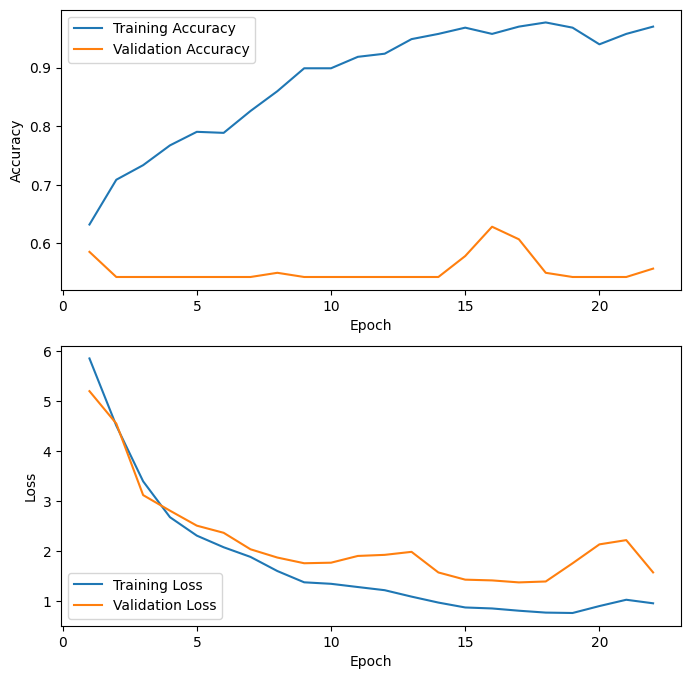

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v3 = ModelCheckpoint(
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V3.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
HCM_V3_fitted = HCM_V3.fit(
    ds_train,
    validation_data = ds_val,
    epochs = 50,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v3])

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V3_fitted, model_name = model_name)

5/5 [==============================] - 4s 677ms/step
True Negatives:  49
False Positives:  15
False Negatives:  37
True Positives:  39
Total Positive Images:  76


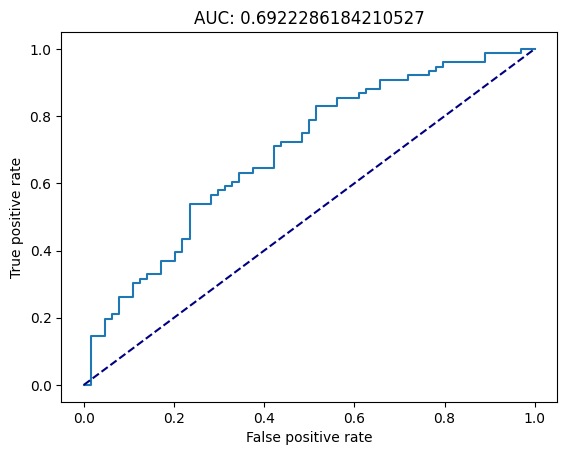

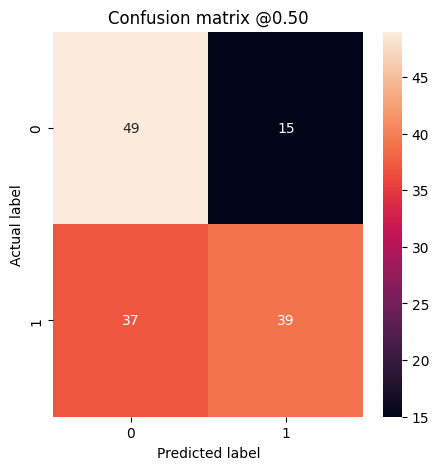

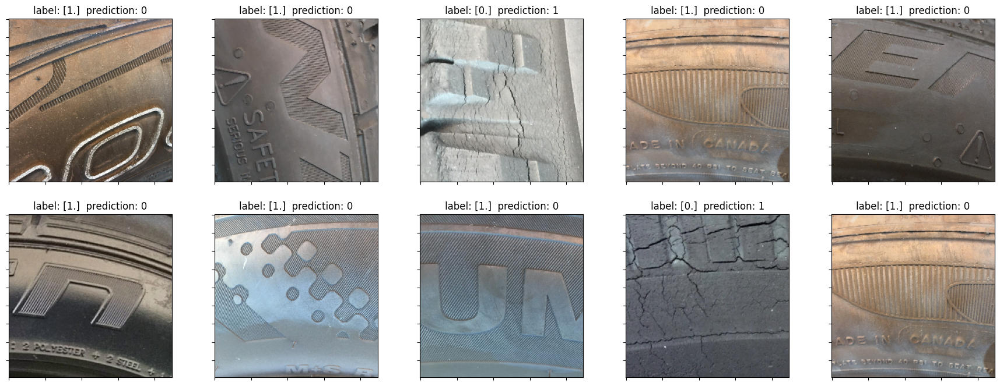

In [ ]:
HCM_V3.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V3, ds_val)

#Plot curves with data from google_drive:
plot_curves(model_fit = None, model_name = model_name)

Despite the inclusion of ``batch normalization``, there was no observable improvement in model performance. The training accuracy remained high while the validation accuracy, which is our target metric, showed very little improvement and continued to yield poor results. These observations indicated significant overfitting, leading to the decision to remove ``batch normalization`` from the model architecture for now.

### 3.4.6 Handcrafted Model Vers_4


The next step is to replace ``AvgPooling`` with ``MaxPooling``, which may have several potential benefits:

- **Increased sensitivity to subtle damage patterns**: Since Max Pooling captures the strongest features in a local area of input, it can help improve our model's ability to detect subtle or high frequency damage patterns in tire images. This could lead to improved accuracy in detecting small punctures, cuts, or other irregularities. (See Girshick, et al, 2014)[5].

- **Maintaining important details**: In the context of tire damage detection, it is critical to maintain detailed information about the condition of the tire. Max Pooling can help achieve this by reducing the risk of oversmoothing that can result from Average Pooling, which mixes important features with noise. In this way, our model may be better able to detect and distinguish between different types of tire damage. (See Srivastava et al., 2014)[6].

- **Robustness to small shifts**: Tire images can have slight variations in the positioning of damage features due to different viewing angles or lighting conditions. Max Pooling provides some degree of translation invariance by maintaining the maximum value within a pooling region, regardless of the exact location of the highest activation. This makes our model more robust to such variations and improves its overall performance. (See LeCun et al., 1998)[7].


However, it is important to remember that the choice between AvgPooling and MaxPooling should be based on the specific characteristics and requirements of our input data. In some cases, AvgPooling may perform better because it can maintain a more balanced representation of features. Still, in the following, the experiment is performed with MaxPooling.


In [ ]:
model_name ="HCM_V4"

HCM_V4 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers
    layers.Dense(units=120, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.Dense(units=84, activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V4.summary()


Model: "HCM_V4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                            

Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 5.0953 - accuracy: 0.5044
Epoch 1: val_accuracy improved from -inf to 0.54286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V4.h5
18/18 [==============================] - 15s 496ms/step - loss: 5.0953 - accuracy: 0.5044 - val_loss: 3.5963 - val_accuracy: 0.5429
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 3.0664 - accuracy: 0.5329
Epoch 2: val_accuracy did not improve from 0.54286
18/18 [==============================] - 21s 921ms/step - loss: 3.0664 - accuracy: 0.5329 - val_loss: 2.5757 - val_accuracy: 0.5429
Epoch 3/50
16/18 [=========================>....] - ETA: 0s - loss: 2.3301 - accuracy: 0.5273
Epoch 3: val_accuracy did not improve from 0.54286
18/18 [==============================] - 14s 570ms/step - loss: 2.3074 - accuracy: 0.5329 - val_loss: 2.0462 - val_accuracy: 0.5429
Epoch 4/50
16/18 [=========================>....] - ETA: 0s 

,Epoch,accuracy,val_accuracy,accuracy_difference
45,46,0.555950,0.542857,0.01
46,47,0.531083,0.542857,-0.01
47,48,0.566607,0.542857,0.02
48,49,0.548845,0.542857,0.01
49,50,0.532860,0.542857,-0.01


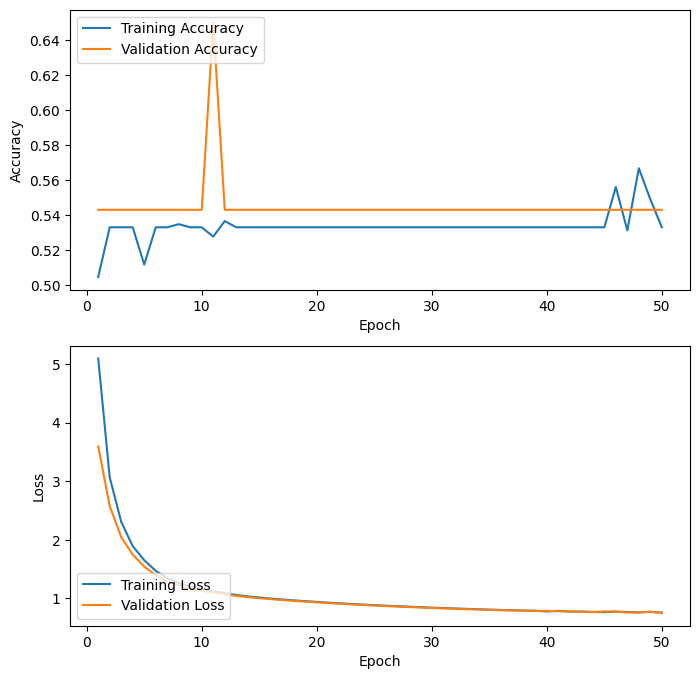

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v4 = ModelCheckpoint(
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V4.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V4_fitted = HCM_V4.fit(
    ds_train,
    validation_data = ds_val,
    epochs = 50,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v4])

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V4_fitted, model_name = model_name)

5/5 [==============================] - 3s 464ms/step
True Negatives:  16
False Positives:  48
False Negatives:  1
True Positives:  75
Total Positive Images:  76


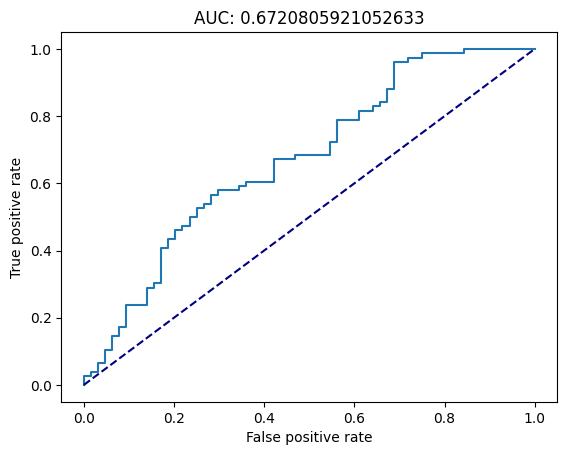

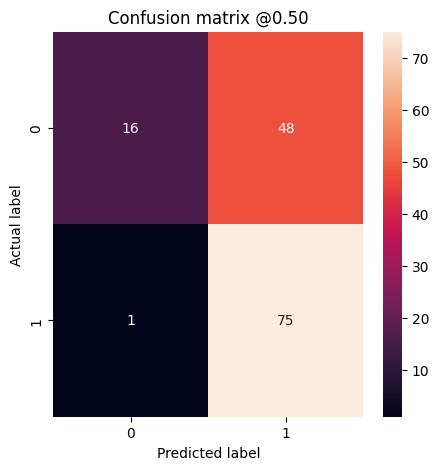

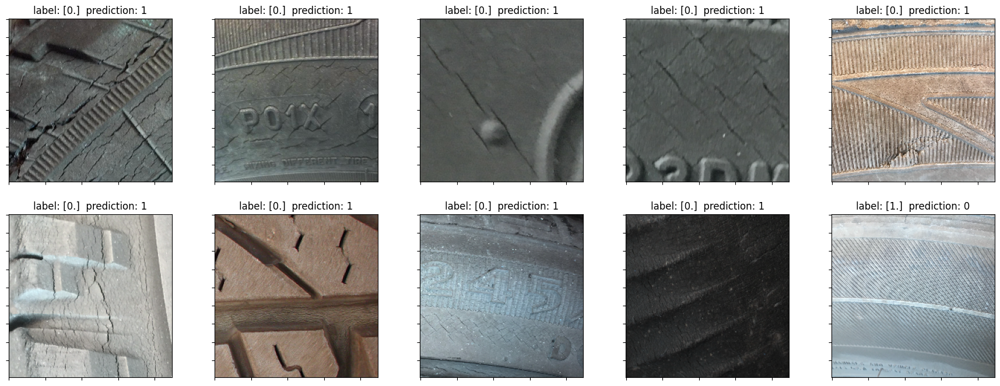

In [ ]:
HCM_V4.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V4, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

The model currently shows severe underfitting. While the training and validation loss is slowly decreasing, the training and validation accuracy seem to be stuck.

Possible explanations for this are:

- **Model Complexity**: A simple model might have difficulty capturing the features and patterns in the data, leading to underfitting (Source: Goodfellow et al., 2016)[1]. This could indicate that our current model may not be complex enough to effectively capture the existing features in the data.

- **Insufficient training data**: If the model does not have enough training data, it cannot learn enough information to identify patterns and relationships in the data (Source: Goodfellow et al., 2016)[1]. Expanding the data set could help address the underfitting problem. For efficiency reasons, we will address this at a later stage and not yet.

To address the underfitting problem in our tire damage detection model, we now turn to version 5 of the hand-built model.

## 3.4.7 Handcrafted Model Vers_5

In this version of the handcrafted model, several changes are made to tackle the issue of underfitting observed in version 4. The underfitting problem can be a result of a model that is not complex enough to capture the features and patterns present in the dataset. To address this issue, the following modifications are made:

- **Additional Convolutional layer**: By adding another convolutional layer to the neural network, we increase the model's ability to capture more complex features and patterns in the input data. This can lead to better generalization and improved performance. Convolutional layers are particularly effective in image recognition tasks as they can detect local patterns and are translation invariant (Source: Goodfellow et al., 2016)[1].

- **Kernel Initializers**: The weights of a neural network should be initialized carefully to ensure proper training. Kernel initializers determine how the weights in the model are set before training starts. Appropriate initialization can speed up convergence and prevent vanishing or exploding gradients (See Glorot and Bengio, 2010)[13]. Some popular initializers include Glorot (Xavier) and He initialization.

- **Additional Dense Layers**: Increasing the number of dense (fully connected) layers in the model can help to capture higher-level features and improve the overall performance of the network. However, adding too many dense layers can increase the risk of overfitting, as the model becomes more complex and may fit to noise in the data (See Srivastava et al., 2014)[6]

- **Dropout Layers**: Dropout is a regularization technique that helps to reduce overfitting by randomly dropping out (setting to zero) a fraction of the neurons during training. This forces the network to learn more robust features and prevents it from relying too heavily on any single neuron. Dropout has been shown to be an effective regularization method for deep neural networks (See Srivastava et al., 2014)[6]

- **Decrease Learning Rate**: Reducing the learning rate can help to stabilize training and improve convergence. A smaller learning rate means that the model's weights are updated more slowly, which can lead to better generalization but may require more epochs to reach optimal performance. It is important to strike a balance between a learning rate that is too high (which may cause unstable training) and too low (which may require more training time) (Source: Goodfellow et al., 2016)[1].

These modifications aim to increase the model's complexity and improve its ability to generalize from the dataset, leading to better performance and mitigating the underfitting issue seen in version 4. However, it is essential to monitor the training process and adjust these parameters as necessary to avoid overfitting and achieve the best possible performance.


In [ ]:
model_name ="HCM_V5"


HCM_V5 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(3, 3), activation='relu', kernel_regularizer=regularizers.l2(0.02), kernel_initializer=initializers.GlorotNormal(seed=seed)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02), kernel_initializer=initializers.GlorotNormal(seed=seed)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 3. conv layer
    layers.Conv2D(filters=32, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02), kernel_initializer=initializers.GlorotNormal(seed=seed)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_regularizer=regularizers.l2(0.02), kernel_initializer=initializers.GlorotNormal(seed=seed)),
    Dropout(0.2),
    layers.Dense(units=84, activation='relu', kernel_regularizer=regularizers.l2(0.02), kernel_initializer=initializers.GlorotNormal(seed=seed)),
    Dropout(0.2),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V5.summary()

Model: "HCM_V5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 6)       168       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 6)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 107, 107, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                            

Epoch 1/50
16/18 [=========================>....] - ETA: 0s - loss: 0.9992 - accuracy: 0.5977
Epoch 1: val_accuracy improved from -inf to 0.57143, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V5.h5
18/18 [==============================] - 15s 480ms/step - loss: 0.9958 - accuracy: 0.6075 - val_loss: 0.9927 - val_accuracy: 0.5714
Epoch 2/50
16/18 [=========================>....] - ETA: 0s - loss: 0.9633 - accuracy: 0.6484
Epoch 2: val_accuracy improved from 0.57143 to 0.57857, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V5.h5
18/18 [==============================] - 12s 491ms/step - loss: 0.9658 - accuracy: 0.6483 - val_loss: 0.9758 - val_accuracy: 0.5786
Epoch 3/50
16/18 [=========================>....] - ETA: 0s - loss: 0.9512 - accuracy: 0.6484
Epoch 3: val_accuracy did not improve from 0.57857
18/18 [==============================] - 12s 475ms/step - loss: 0.9478 - accurac

,Epoch,accuracy,val_accuracy,accuracy_difference
45,46,0.712256,0.678571,0.03
46,47,0.730018,0.685714,0.04
47,48,0.717584,0.678571,0.04
48,49,0.701599,0.685714,0.02
49,50,0.721137,0.657143,0.06


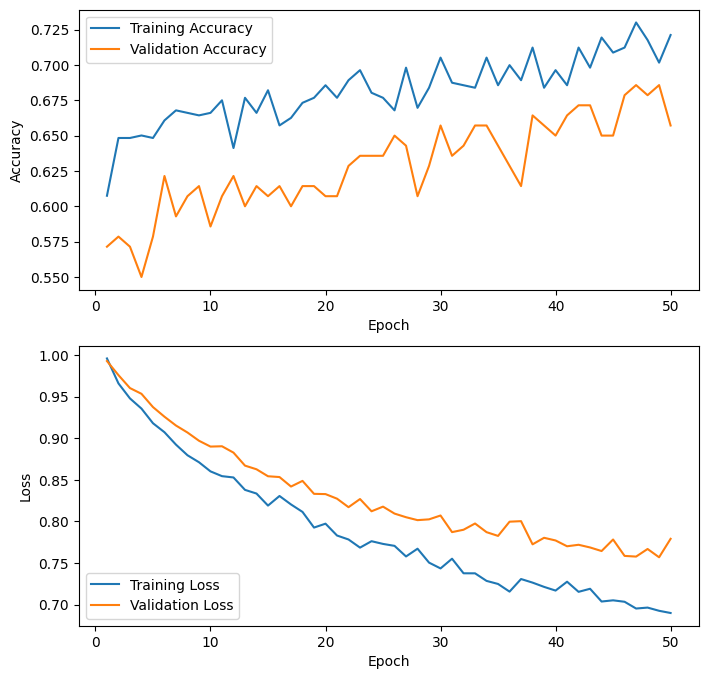

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v5 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V5.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V5_fitted = HCM_V5.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v5])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V5_fitted, model_name = model_name)                                                                               #Change here

5/5 [==============================] - 3s 475ms/step
True Negatives:  39
False Positives:  25
False Negatives:  19
True Positives:  57
Total Positive Images:  76


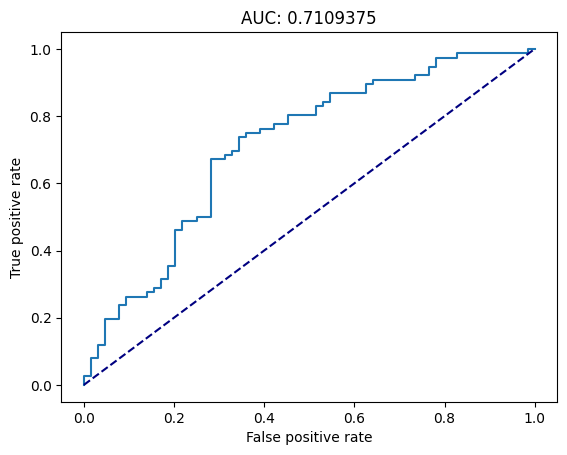

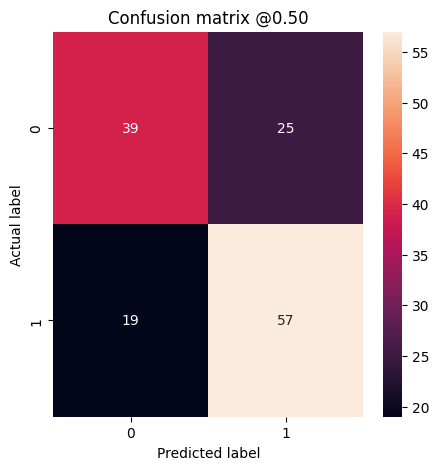

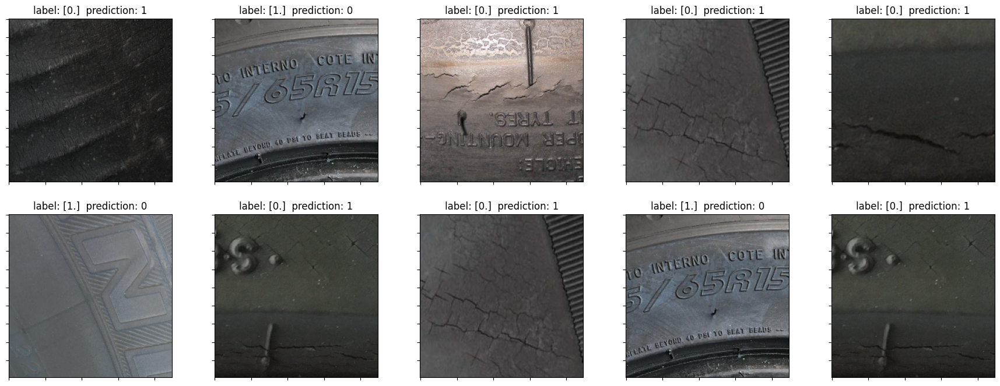

In [ ]:
HCM_V5.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V5, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

We found that the model is currently underfitted, as evidenced by the slow increase in training and validation accuracy. While the model reached its highest validation accuracy of 0.65 at epoch 26, this level of performance may not be sufficient for practical applications. To address this issue, we propose the following approaches:

- **More Epochs**: Giving the model more time to learn from the data could potentially improve its performance, which will be used later on the process (See Srivastava et al., 2014)[6]

- **Increasing the complexity or capacity of the model**: To improve the model's ability to learn from the data, additional layers can be added, the number of units in the existing layers can be increased, or a larger or more powerful pre-trained model can be used to fit the data set. These changes can enable the model to learn more complex features and thus improve its performance (See LeCun et al., 1998[7]; Howard et al., 2018 [8]).
However, we must be wary of overfitting. Techniques such as dropout or L1/L2 regularization can help prevent overfitting during long training periods (Goodfellow et al., 2016)[1].




### 3.4.8 Handcrafted Model Vers_6

To improve the model's performance, a new architecture was introduced that includes additional dense layers, dropout, and batch normalization. 
These techniques aim to increase the model's capacity and implement regularization to prevent overfitting. The new model architecture consists of a dense layer with 120 units, followed by ``batch normalization`` and ``dropout`` with a rate of 0.2. This is then followed by two more ``dense layers``, each with 84 and 64 units, respectively and ``batch normalization`` and ``dropout`` with a rate of 0.2 applied after each layer:

- **Batch Normalization**: Batch normalization was applied after each dense layer to stabilize and accelerate the learning process. It works by normalizing the input to each layer, reducing internal covariate shift, and allowing for faster and more stable convergence (see Ioffe and Szegedy, 2015)[4].

- **Dropout with a Rate of 0.2**: Dropout was used as a regularization technique to prevent overfitting. It randomly drops out a certain proportion of the units in the layer during training, forcing the remaining units to learn more robust features (See Srivastava et al., 2014)[6]). A rate of 0.2 was chosen based on experimentation and is a common value used in deep learning.





In [ ]:
model_name ="HCM_V6"

HCM_V6 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    BatchNormalization(),
    Dropout(0.2),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    BatchNormalization(),
    Dropout(0.2),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    BatchNormalization(),
    Dropout(0.2),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V6.summary()


Model: "HCM_V6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                            

Epoch 1/50
17/18 [===========================>..] - ETA: 0s - loss: 1.0436 - accuracy: 0.5974
Epoch 1: val_accuracy improved from -inf to 0.54286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V6.h5
18/18 [==============================] - 18s 486ms/step - loss: 1.0258 - accuracy: 0.6092 - val_loss: 1.0593 - val_accuracy: 0.5429
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.8826 - accuracy: 0.6785
Epoch 2: val_accuracy improved from 0.54286 to 0.56429, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V6.h5
18/18 [==============================] - 17s 743ms/step - loss: 0.8826 - accuracy: 0.6785 - val_loss: 0.9689 - val_accuracy: 0.5643
Epoch 3/50
17/18 [===========================>..] - ETA: 0s - loss: 0.8280 - accuracy: 0.7224
Epoch 3: val_accuracy did not improve from 0.56429
18/18 [==============================] - 14s 574ms/step - loss: 0.8255 - accurac

,Epoch,accuracy,val_accuracy,accuracy_difference
14,15,0.934281,0.664286,0.27
15,16,0.959147,0.650000,0.31
16,17,0.943162,0.578571,0.36
17,18,0.959147,0.614286,0.34
18,19,0.960924,0.642857,0.32


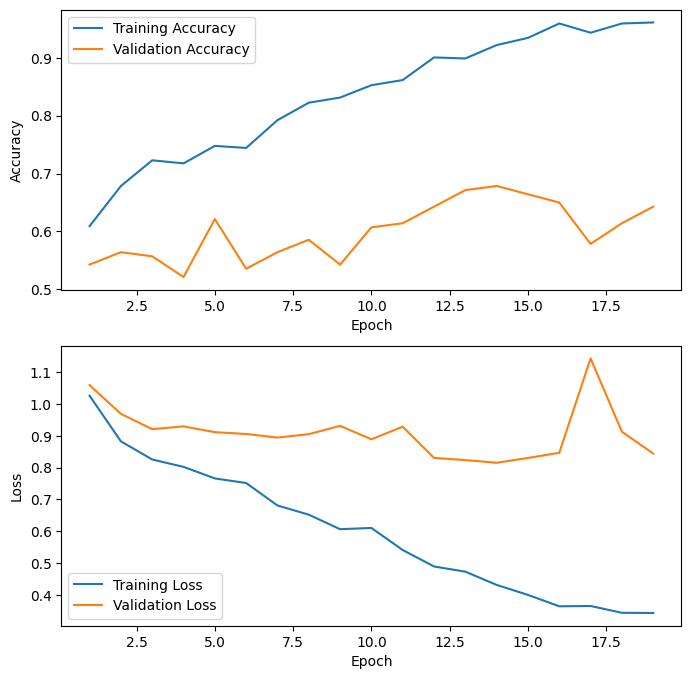

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v6 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V6.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V6_fitted = HCM_V6.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v6])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V6_fitted, model_name = model_name) 

5/5 [==============================] - 4s 824ms/step
True Negatives:  27
False Positives:  37
False Negatives:  8
True Positives:  68
Total Positive Images:  76


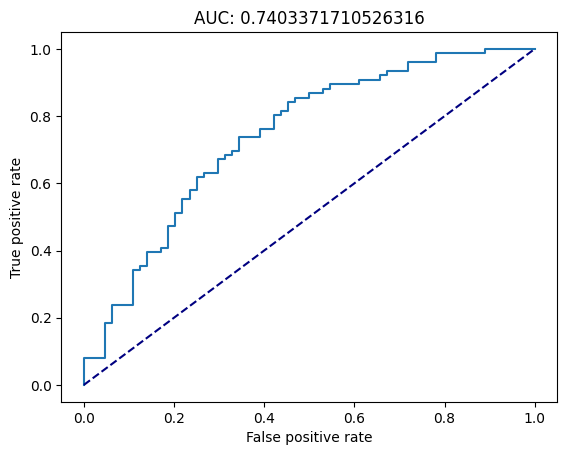

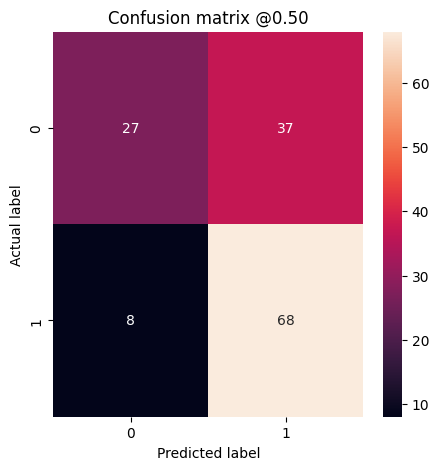

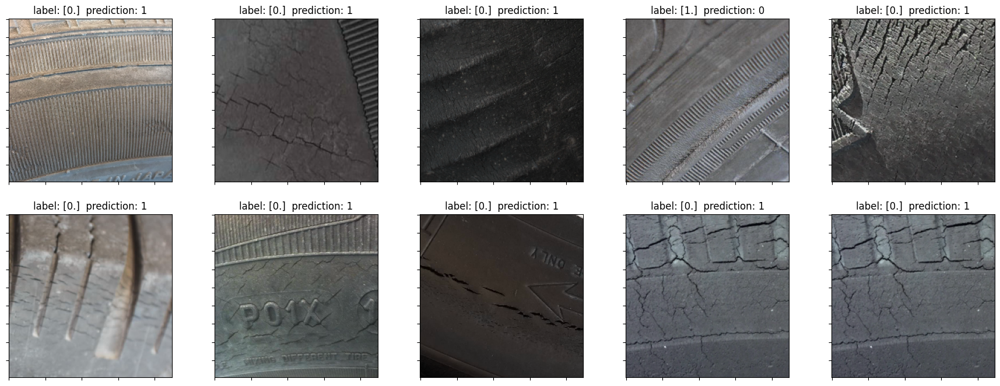

In [ ]:
HCM_V6.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V6, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

 

The primary goal of the Handcrafted Model Vers_6 was to enhance the model's capacity and incorporate regularization techniques to mitigate overfitting. Upon completion, the model reached a validation accuracy of 0.6786 at epoch 14, with early stopping triggered at epoch 19. The learning curves show clear signs of overfitting again, which means that the model complexity is too high.

However, since ``Batch Normalization`` previously led to issues in the model (as observed in step 3), it is decided to remove this technique and reassess the model's performance in the subsequent iteration.

This decision aims to refine the model further by eliminating any potential complications introduced by Batch Normalization while maintaining the other changes to the architecture.

### 3.4.9 Handcrafted Model Vers_7

Since BatchNormalisation caused problems before (see step 3) it is removed again, and the model Vers_6 is tried again without ``Batch Normalization``.


In [ ]:
model_name ="HCM_V7"

HCM_V7 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.02)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
 
    Dropout(0.2),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
   
    Dropout(0.2),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    
    Dropout(0.2),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V7.summary()

Model: "HCM_V7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                            

Epoch 1/50
16/18 [=========================>....] - ETA: 0s - loss: 0.9605 - accuracy: 0.5176
Epoch 1: val_accuracy improved from -inf to 0.54286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V7.h5
18/18 [==============================] - 15s 494ms/step - loss: 0.9648 - accuracy: 0.5169 - val_loss: 0.9405 - val_accuracy: 0.5429
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.9505 - accuracy: 0.4973
Epoch 2: val_accuracy improved from 0.54286 to 0.56429, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V7.h5
18/18 [==============================] - 13s 531ms/step - loss: 0.9505 - accuracy: 0.4973 - val_loss: 0.9292 - val_accuracy: 0.5643
Epoch 3/50
17/18 [===========================>..] - ETA: 0s - loss: 0.9295 - accuracy: 0.4945
Epoch 3: val_accuracy improved from 0.56429 to 0.62143, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handc

,Epoch,accuracy,val_accuracy,accuracy_difference
21,22,0.767318,0.657143,0.11
22,23,0.792185,0.685714,0.11
23,24,0.797513,0.664286,0.13
24,25,0.813499,0.700000,0.11
25,26,0.790409,0.671429,0.12


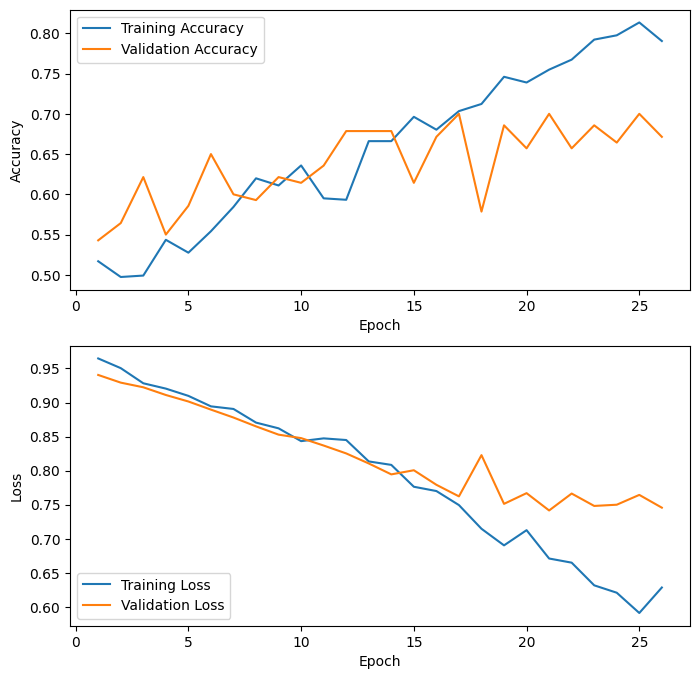

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v7 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V7.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V7_fitted = HCM_V7.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v7])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V7_fitted, model_name = model_name) 

5/5 [==============================] - 5s 838ms/step
True Negatives:  38
False Positives:  26
False Negatives:  16
True Positives:  60
Total Positive Images:  76


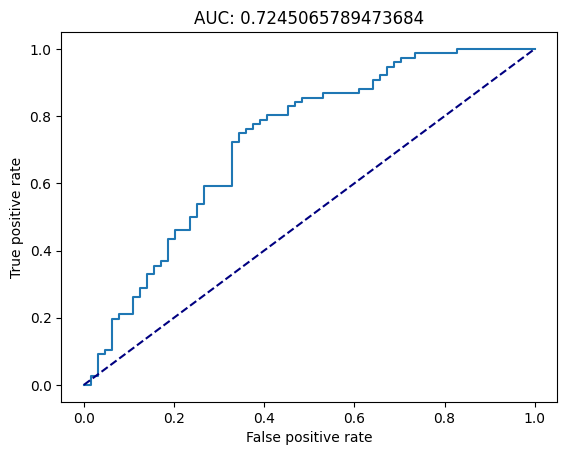

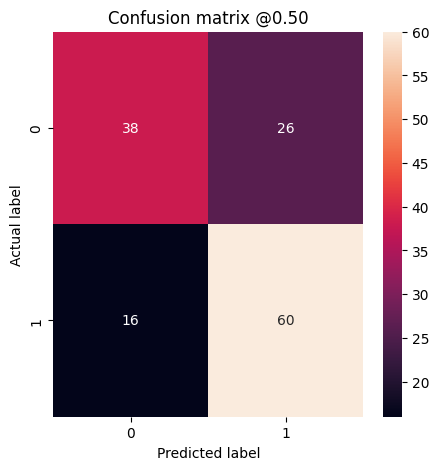

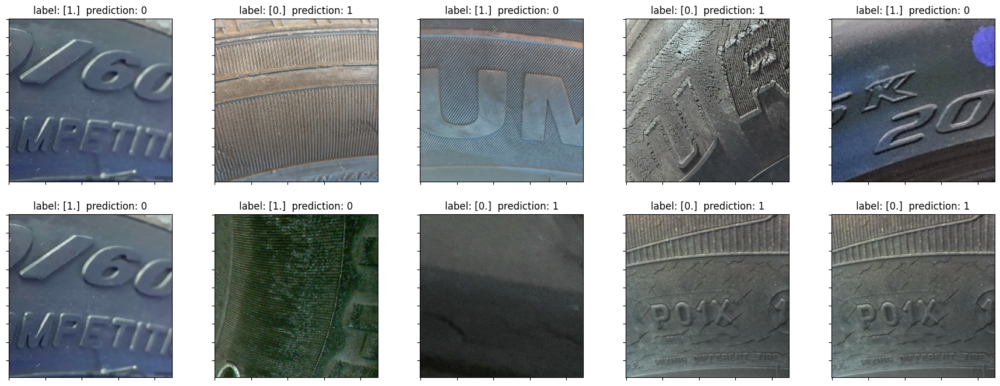

In [ ]:
HCM_V7.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V7, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

The model without Batch Normalization displays promising training accuracy but begins to overfit after epoch 17. The final model achieved a validation accuracy of 0.7 at epoch 17 before showing signs of overfitting. It is important to note that although the model's performance has improved compared to previous iterations, it still does not exhibit optimal performance.

Several factors could be contributing to the model's suboptimal performance:

- **Insufficient Regularization**: The model may require more regularization techniques, such as Dropout or L1/L2 regularization, to prevent overfitting and improve generalization.

- **Model Complexity**: The current model architecture might be too complex for the given task. Simplifying the model, such as reducing the number of layers or neurons, could lead to better generalization.

- **Feature Transformation**: The model may benefit from better feature engineering, which includesthe Convolution to enhance the model's ability to learn from the input data.

In summary, the model without Batch Normalization exhibits improved performance compared to earlier iterations, but further adjustments and experimentation may be necessary to achieve optimal results.

### 3.4.10 Handcrafted Model Vers_8

To further improve the model and address the issues mentioned above, we will make some changes in this new model. We will increase the regularization techniques and dropout rates to prevent overfitting:

- The ``kernel_regularizer L2`` in the convolutional layer will be increased from 0.02 to 0.04.
- The ``dropout rate`` of the fully connected dense layer will be increased from 0.2 to 0.4.

These adjustments aim to increase the robustness of the model and allow for better generalization to new, unseen data. By experimenting with these modified settings, we hope to further improve the performance of the model and achieve optimal results.

In [ ]:
model_name = "HCM_V8"

HCM_V8 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.04)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.04)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
 
    Dropout(0.4),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
   
    Dropout(0.4),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    
    Dropout(0.4),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V8.summary()

Model: "HCM_V8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d_4 (Conv2D)           (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 110, 110, 6)      0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                            

Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 1.2667 - accuracy: 0.4849
Epoch 1: val_accuracy improved from -inf to 0.54286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V8.h5
18/18 [==============================] - 16s 521ms/step - loss: 1.2667 - accuracy: 0.4849 - val_loss: 1.1873 - val_accuracy: 0.5429
Epoch 2/50
16/18 [=========================>....] - ETA: 0s - loss: 1.1845 - accuracy: 0.5312
Epoch 2: val_accuracy improved from 0.54286 to 0.58571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V8.h5
18/18 [==============================] - 14s 459ms/step - loss: 1.1809 - accuracy: 0.5311 - val_loss: 1.1714 - val_accuracy: 0.5857
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 1.1664 - accuracy: 0.5346
Epoch 3: val_accuracy did not improve from 0.58571
18/18 [==============================] - 16s 604ms/step - loss: 1.1664 - accurac

,Epoch,accuracy,val_accuracy,accuracy_difference
38,39,0.841918,0.735714,0.11
39,40,0.836590,0.678571,0.16
40,41,0.847247,0.735714,0.11
41,42,0.865009,0.671429,0.19
42,43,0.852575,0.678571,0.17


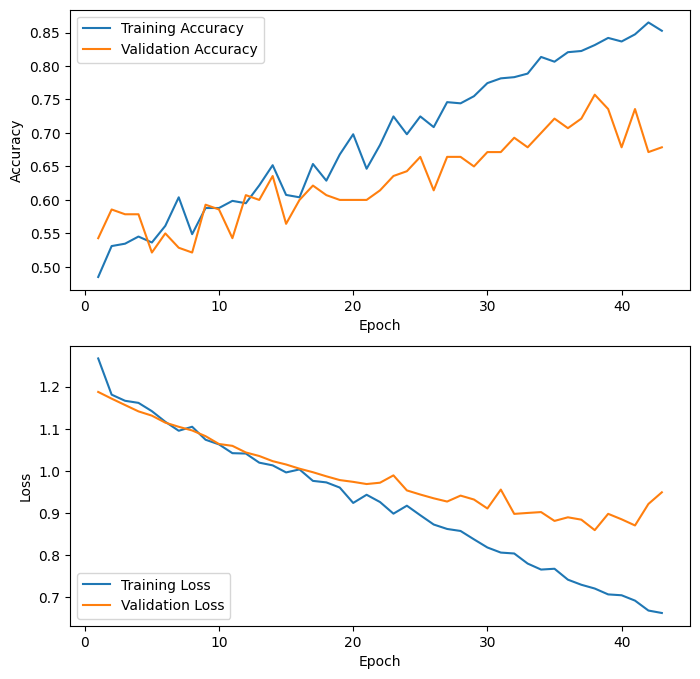

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v8 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V8.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V8_fitted = HCM_V8.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50,
    verbose=1,
    callbacks=[early_stopping, checkpoint_v8])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V8_fitted, model_name = model_name) 

5/5 [==============================] - 3s 633ms/step
True Negatives:  44
False Positives:  20
False Negatives:  14
True Positives:  62
Total Positive Images:  76


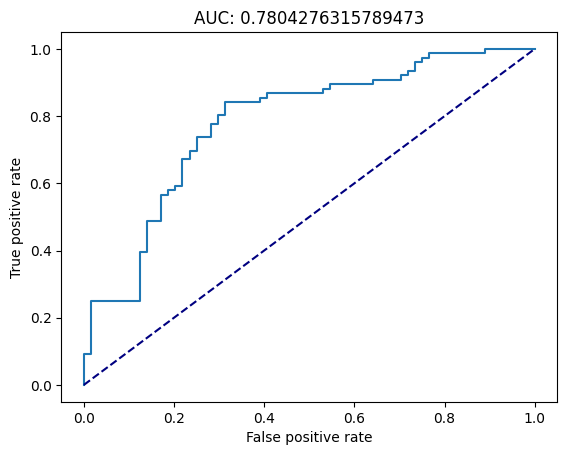

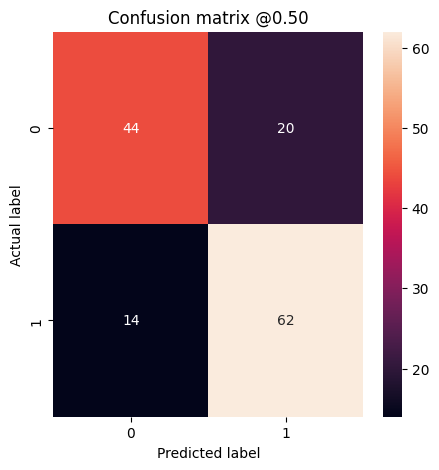

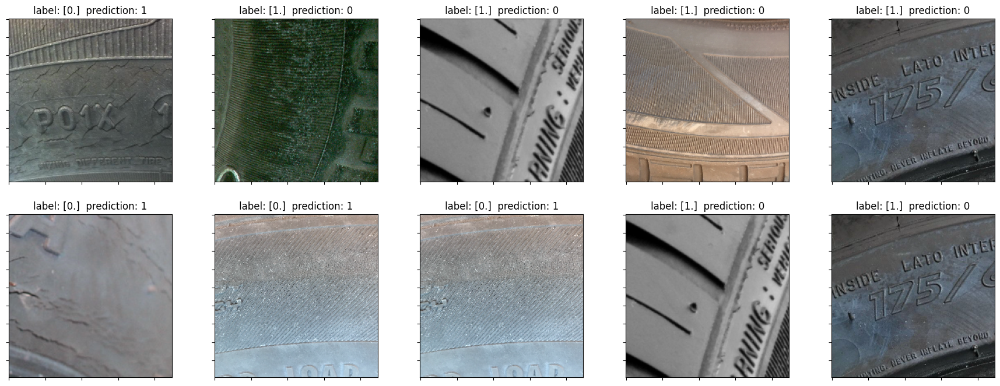

In [ ]:
HCM_V8.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V8, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

This trail looks very promising with a validation accuracy of 0.75. However, it can be seen, that the model still starts to overfit in the later epochs. To test this architecture further, more epochs will be added in the next run and the learning rate will be decreased:

*Decrease Learning Rate*: Reducing the learning rate can help to stabilize training and improve convergence. A smaller learning rate means that the model's weights are updated more slowly, which can lead to better generalization but may require more epochs to reach optimal performance. It is important to strike a balance between a learning rate that is too high (which may cause unstable training) and too low (which may require more training time) (See Goodfellow et al., 2016)[1]

### 3.4.11 Handcrafted Model Vers_9

In version 8, our model showed promising results with a validation accuracy of 0.75. However, it was observed that the model still tends to overfit in later epochs. To further test this architecture, version 9 adds more ``epochs`` to a total of 100 and reduces the ``learning rate`` to 0.00005.


With this adjustment to the learning rate in version 9, we hope to further reduce the overfitting problems of previous iterations and achieve higher validation accuracy.

In [ ]:
model_name = "HCM_V9"

HCM_V9 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.04)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.04)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
 
    Dropout(0.4),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
   
    Dropout(0.4),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    
    Dropout(0.4),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V9.summary()

Model: "HCM_V9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d_2 (Conv2D)           (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 110, 110, 6)      0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                            

Epoch 1/100
18/18 [==============================] - ETA: 0s - loss: 1.2101 - accuracy: 0.5329
Epoch 1: val_accuracy improved from -inf to 0.55000, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V9.h5
18/18 [==============================] - 15s 486ms/step - loss: 1.2101 - accuracy: 0.5329 - val_loss: 1.1873 - val_accuracy: 0.5500
Epoch 2/100
18/18 [==============================] - ETA: 0s - loss: 1.1887 - accuracy: 0.5453
Epoch 2: val_accuracy improved from 0.55000 to 0.61429, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V9.h5
18/18 [==============================] - 13s 555ms/step - loss: 1.1887 - accuracy: 0.5453 - val_loss: 1.1736 - val_accuracy: 0.6143
Epoch 3/100
18/18 [==============================] - ETA: 0s - loss: 1.1828 - accuracy: 0.4991
Epoch 3: val_accuracy did not improve from 0.61429
18/18 [==============================] - 14s 615ms/step - loss: 1.1828 - accu

,Epoch,accuracy,val_accuracy,accuracy_difference
78,79,0.843695,0.714286,0.13
79,80,0.815275,0.728571,0.09
80,81,0.850799,0.728571,0.12
81,82,0.841918,0.714286,0.13
82,83,0.840142,0.721429,0.12


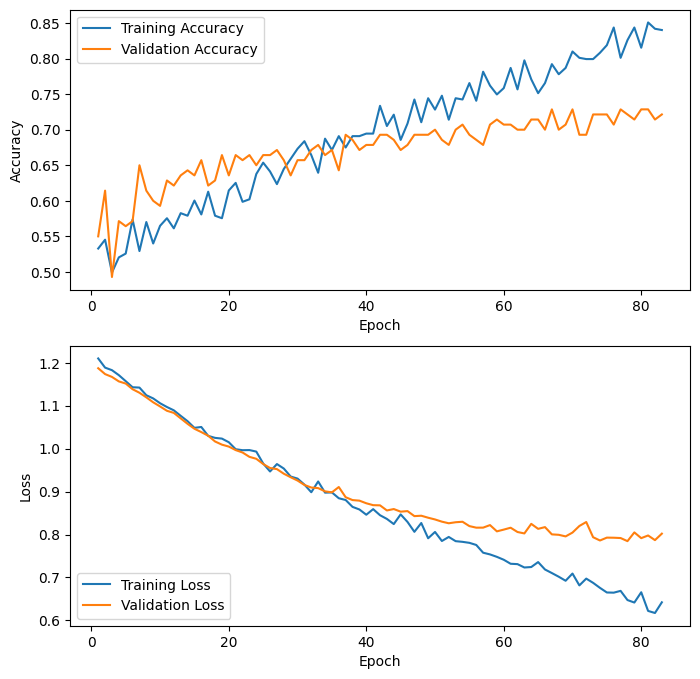

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v9 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V9.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.00005),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V9_fitted = HCM_V9.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 100, # more epochs
    verbose=1,
    callbacks=[early_stopping, checkpoint_v9])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V9_fitted, model_name = model_name) 

5/5 [==============================] - 3s 482ms/step
True Negatives:  39
False Positives:  25
False Negatives:  13
True Positives:  63
Total Positive Images:  76


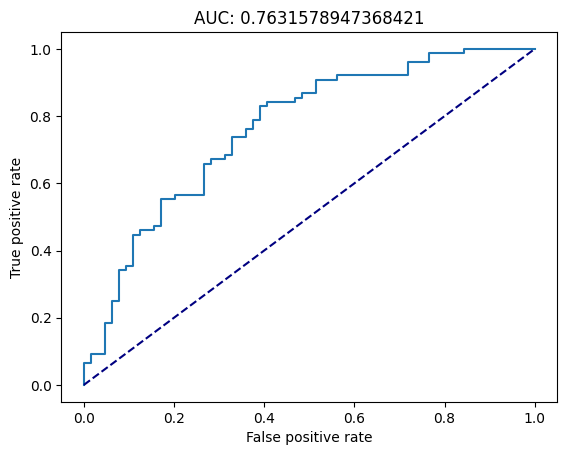

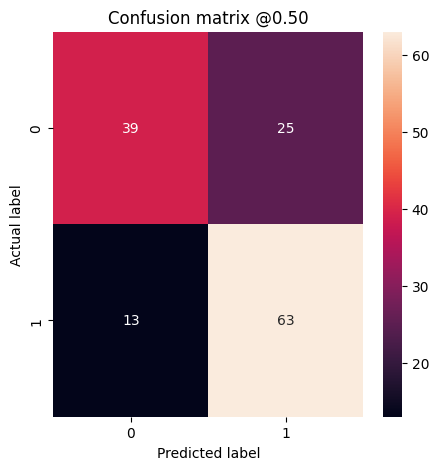

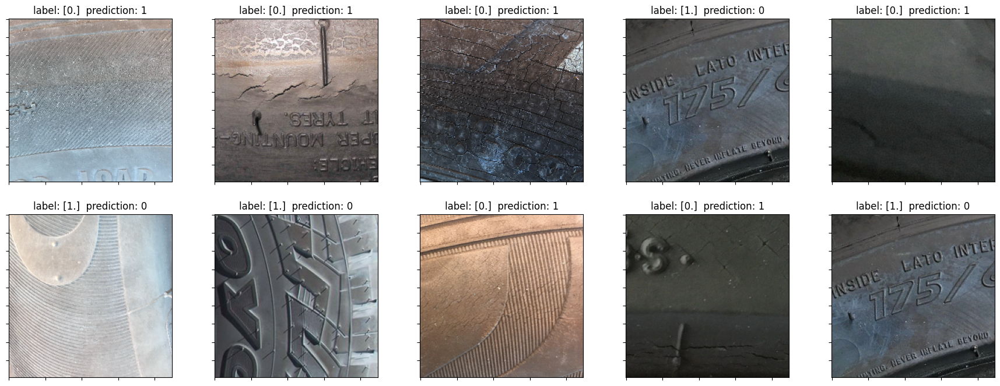

In [ ]:
HCM_V9.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V9, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

The reduction in learning rate succeeded in stabilizing the model; however, after 83 epochs, the validation accuracy did not show significant improvement. Additionally, the model began to overfit the training set once again, starting around epoch 40.

Considering these observations, the number of ``epochs`` and the ``learning rate`` will be reverted to their previous values. The current methodology is deemed inefficient and not feasible for achieving the desired performance.



### 3.4.12 Handcrafted Model Vers_10

Building on the insights gained from version 8, we introduce Step 10, which aims to increase the regularizer and dropout rate to further mitigate overfitting. In this new model iteration, the following changes are implemented:

- The ``kernel_regularizer`` for the convolutional layer will be increased from 0.04 to 0.06, promoting better generalization by adding a penalty on the weights during training.
- The ``dropout rate`` of the fully connected dense layers will be raised from 0.4 to 0.6, adding a more robust noise injection mechanism that helps the model to be less reliant on specific features.
By adjusting these regularization parameters, we hope to improve the model's ability to generalize and achieve higher validation accuracy while avoiding overfitting.




In [ ]:
model_name = "HCM_V10"

HCM_V10 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
 
    Dropout(0.6),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
   
    Dropout(0.6),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    
    Dropout(0.6),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V10.summary()

Model: "HCM_V10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d_2 (Conv2D)           (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_3 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                           

Epoch 1/50
16/18 [=========================>....] - ETA: 0s - loss: 1.4699 - accuracy: 0.5117
Epoch 1: val_accuracy improved from -inf to 0.53571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V10.h5
18/18 [==============================] - 18s 555ms/step - loss: 1.4640 - accuracy: 0.5151 - val_loss: 1.4291 - val_accuracy: 0.5357
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 1.4360 - accuracy: 0.5258
Epoch 2: val_accuracy did not improve from 0.53571
18/18 [==============================] - 14s 590ms/step - loss: 1.4360 - accuracy: 0.5258 - val_loss: 1.4075 - val_accuracy: 0.4786
Epoch 3/50
16/18 [=========================>....] - ETA: 0s - loss: 1.4128 - accuracy: 0.5039
Epoch 3: val_accuracy did not improve from 0.53571
18/18 [==============================] - 15s 443ms/step - loss: 1.4094 - accuracy: 0.5098 - val_loss: 1.3796 - val_accuracy: 0.5071
Epoch 4/50
18/18 [==============================] - ETA: 0s

,Epoch,accuracy,val_accuracy,accuracy_difference
45,46,0.733570,0.714286,0.02
46,47,0.754885,0.700000,0.05
47,48,0.770870,0.692857,0.08
48,49,0.785080,0.728571,0.06
49,50,0.772647,0.707143,0.07


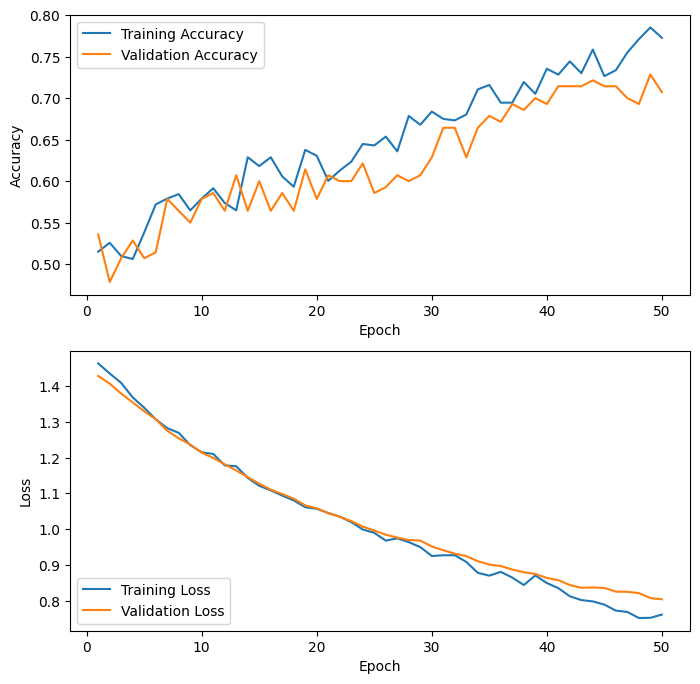

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v10 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V10.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V10_fitted = HCM_V10.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50, 
    verbose=1,
    callbacks=[early_stopping, checkpoint_v10])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V10_fitted, model_name = model_name) 

5/5 [==============================] - 5s 584ms/step
True Negatives:  40
False Positives:  24
False Negatives:  14
True Positives:  62
Total Positive Images:  76


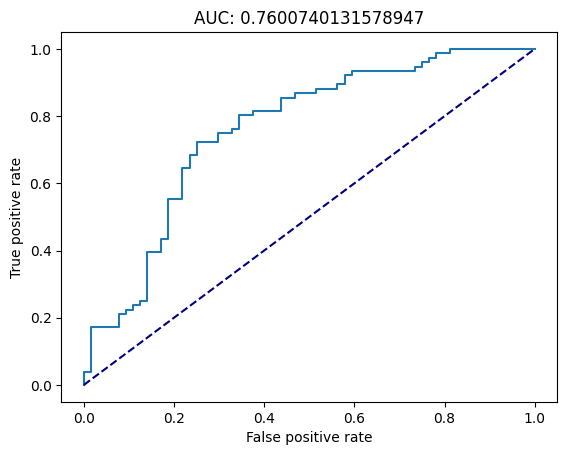

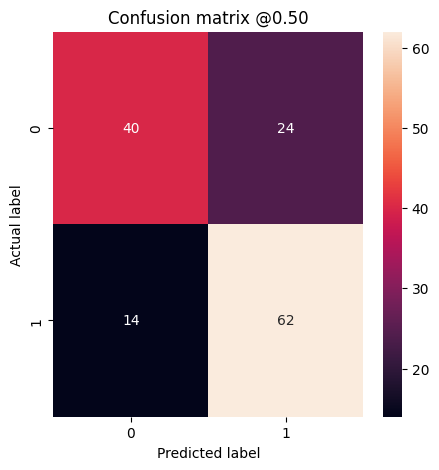

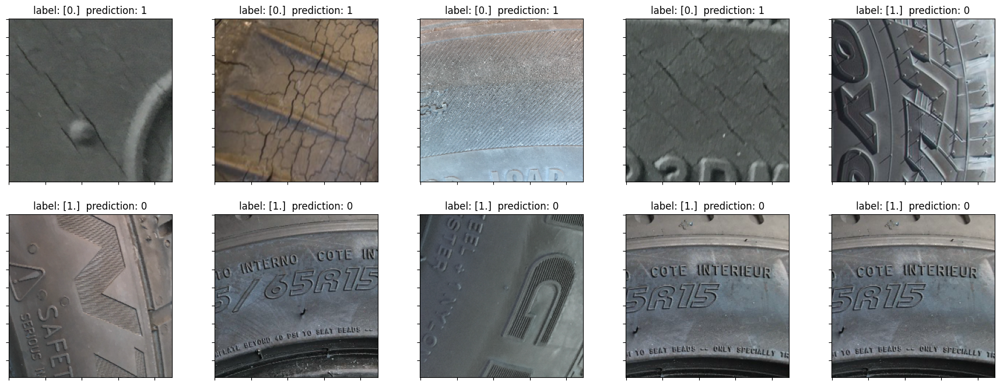

In [ ]:
HCM_V10.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V10, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)



The recent model iteration showed a moderate level of overfitting and yielded a ``validation accuracy of 0.73``. While the performance did not exhibit substantial improvement, a closer examination of the results revealed that the model shows a tendency to predict more normal cases (label 1) than crack cases (label 0). This leads to 24 crack cases being incorrectly classified as normal cases, while only 14 normal cases are classified as crack cases.
To address this issue, adjusting the class weights could be a viable solution.

In the upcoming model iteration, we will set the ``class weight`` for class 0 to {0:1.3, 1:1}, assigning 1.3 times more weight to class 0 than class 1. This approach has the potential to improve the model's ability to differentiate between the two classes more effectively. Research indicates that class-weight adjustments can help balance misclassification costs in imbalanced datasets and improve model performance (See Huang & Ling, 2005)[9].

### 3.4.13 Handcrafted Model Vers_11

By adjusting the class weights of the previous model iteration, we hope to address the misclassification issue and achieve better results.

The ``class weight`` for class 0 will be set to {0:2 , 1:1}, which means that the class 0 will get twice the weight than the class 1

In [ ]:
model_name = "HCM_V11"

HCM_V11 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
 
    Dropout(0.6),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
   
    Dropout(0.6),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    
    Dropout(0.6),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V11.summary()

Model: "HCM_V11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                           

Epoch 1/50
16/18 [=========================>....] - ETA: 0s - loss: 1.6405 - accuracy: 0.5215
Epoch 1: val_accuracy improved from -inf to 0.54286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V11.h5
18/18 [==============================] - 15s 362ms/step - loss: 1.6351 - accuracy: 0.5133 - val_loss: 1.4378 - val_accuracy: 0.5429
Epoch 2/50
17/18 [===========================>..] - ETA: 0s - loss: 1.5461 - accuracy: 0.4816
Epoch 2: val_accuracy did not improve from 0.54286
18/18 [==============================] - 15s 519ms/step - loss: 1.5435 - accuracy: 0.4885 - val_loss: 1.4100 - val_accuracy: 0.4571
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 1.5001 - accuracy: 0.4956
Epoch 3: val_accuracy did not improve from 0.54286
18/18 [==============================] - 12s 403ms/step - loss: 1.5001 - accuracy: 0.4956 - val_loss: 1.3832 - val_accuracy: 0.4571
Epoch 4/50
18/18 [==============================] - ETA: 0s

,Epoch,accuracy,val_accuracy,accuracy_difference
45,46,0.536412,0.492857,0.04
46,47,0.548845,0.614286,-0.07
47,48,0.564831,0.621429,-0.06
48,49,0.579041,0.592857,-0.01
49,50,0.605684,0.657143,-0.05


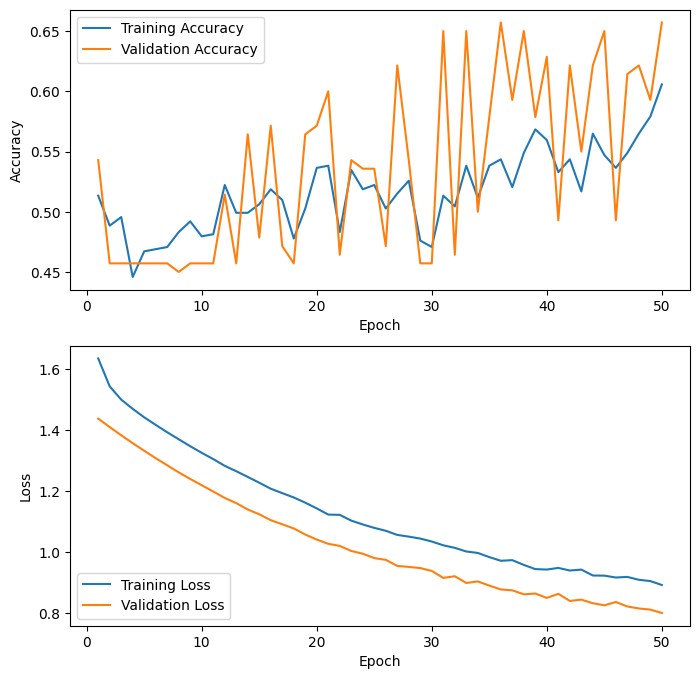

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v11 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V11.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V11_fitted = HCM_V11.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50, 
    class_weight ={0:1.3 , 1:1},
    verbose=1,
    callbacks=[early_stopping, checkpoint_v11])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V11_fitted, model_name = model_name) 

5/5 [==============================] - 3s 600ms/step
True Negatives:  35
False Positives:  29
False Negatives:  19
True Positives:  57
Total Positive Images:  76


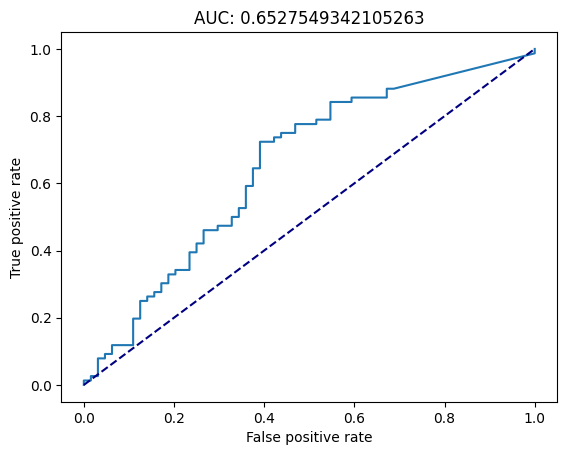

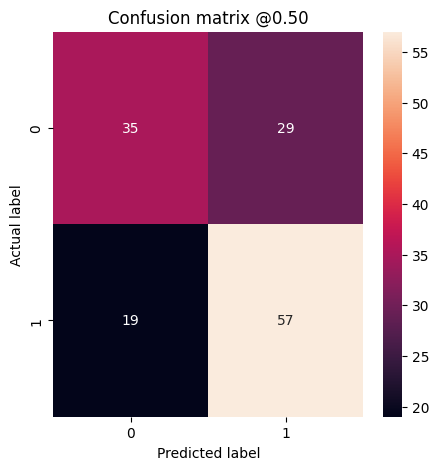

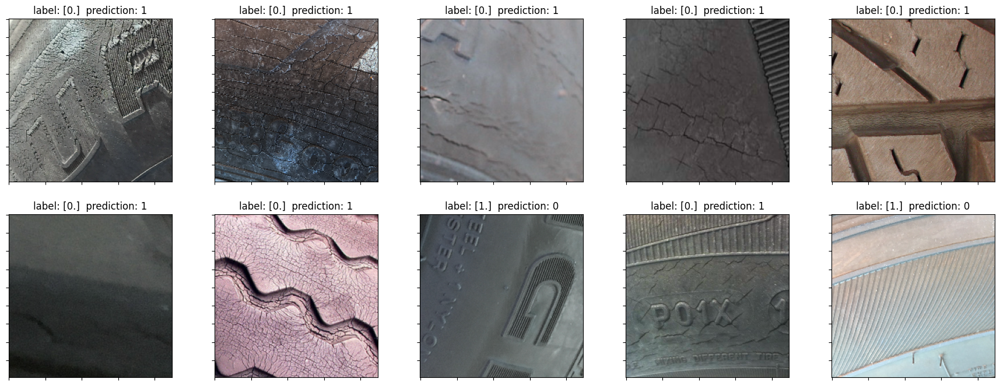

In [ ]:
HCM_V11.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V11, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

In this model, the ``class weights`` were adjusted to improve the performance of the model in classifying unbalanced data. However, the validation accuracy and validation loss showed fluctuations during training, indicating possible problems in fitting the class weights. Misclassified cases increased in both cases from 24 to 29 (cracked, classified as normal) and 14 to 19 (normal, classified as cracked), respectively.

One potential problem with fitting the class weights is overfitting to the minority class. This can result in the model achieving higher accuracy for the minority class at the expense of reduced accuracy for the majority class. This can ultimately affect the overall performance of the model (See Buda,& Mazurowski, 2018)[10]. 

Another issue is that adjusted class weights can affect the validation loss, so it may not be a good indication of model performance. In such cases, validation loss may be an inaccurate measure of model overfitting (See Chawla et al. 2002)[11]

In the next step, we will remove the adjusted class weights from the model to reduce potential problems associated with these variations in validation accuracy and validation loss. This will help us improve the stability and robustness of the model and provide a better understanding of model performance.

### 3.4.14 Handcrafted Model Vers_12
For the updated model, the following changes are implemented:

Steps taken:

- ``Class weights`` are reset to 0:1, 1:1: As discussed earlier, this is done to address the issues encountered in the previous model regarding fluctuating validation accuracy and loss.

- ``The kernel_initializers`` for the fully connected dense layers are changed to ``he_normal()``: This initializer is used because it is particularly effective for deep neural networks with ReLU activation functions. The "he_normal" initialization helps prevent vanishing or exploding gradients, enabling the model to train more effectively (source: He, K., Zhang, X., Ren, S., & Sun, J. (2015). Delving Deep into Rectifiers: Surpassing Human-Level Performance on ImageNet Classification. Proceedings of the IEEE International Conference on Computer Vision (ICCV), 1026-1034).
These changes aim to improve the model's performance by addressing the identified issues and enhancing the training process.

**When using the he_normal()** initializer for the fully connected dense layers, it is beneficial to **reduce the dropout rate and kernel regularizers** for the following reasons:

- ``Dropout rate``: The he_normal() initialization is designed to work well with ReLU activation functions and deep neural networks. It helps maintain the magnitude of the gradients flowing through the network during training (He, K., Zhang, X., Ren, S., & Sun, J. (2015). Delving Deep into Rectifiers: Surpassing Human-Level Performance on ImageNet Classification. Proceedings of the IEEE International Conference on Computer Vision (ICCV), 1026-1034). Reducing the dropout rate allows the model to retain more information and utilize the full capacity of the initialized weights, leading to better learning and performance. Excessive dropout rates might counteract the benefits of the he_normal() initializer by reducing the network's ability to propagate gradients effectively.

- ``Kernel regularizers``: Regularization techniques such as L1 or L2 regularization add a penalty term to the loss function to prevent overfitting. However, when using the he_normal() initializer, which is designed to handle deep networks effectively, reducing the strength of the kernel regularizers can help the model capitalize on the advantages of this initialization method. Over-regularization may limit the model's capacity to learn complex patterns in the data, undermining the benefits provided by the he_normal() initializer (Goodfellow et al, 2016)[1].

In summary, reducing both the dropout rate and kernel regularizers when using the he_normal() initializer allows the model to take full advantage of the improved weight initialization, promoting effective gradient propagation and learning while preventing overfitting.
Therefore, additionally to the implementation of ``he_normal()``, we reduced the ``dropout rate`` to 0.03 and the ``L2 kernel regularizer``to 0.2.





In [ ]:
model_name = "HCM_V12"

HCM_V12 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.2)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.2)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.he_normal()),
 
    Dropout(0.3),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.he_normal()),
   
    Dropout(0.3),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.he_normal()),
    
    Dropout(0.3),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V12.summary()

Model: "HCM_V12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                           

Epoch 1/200
16/18 [=========================>....] - ETA: 0s - loss: 3.3633 - accuracy: 0.5254
Epoch 1: val_accuracy improved from -inf to 0.56429, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V12.h5
18/18 [==============================] - 17s 557ms/step - loss: 3.3545 - accuracy: 0.5222 - val_loss: 3.1368 - val_accuracy: 0.5643
Epoch 2/200
18/18 [==============================] - ETA: 0s - loss: 3.1893 - accuracy: 0.4956
Epoch 2: val_accuracy improved from 0.56429 to 0.64286, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V12.h5
18/18 [==============================] - 14s 590ms/step - loss: 3.1893 - accuracy: 0.4956 - val_loss: 3.0518 - val_accuracy: 0.6429
Epoch 3/200
16/18 [=========================>....] - ETA: 0s - loss: 3.0479 - accuracy: 0.4863
Epoch 3: val_accuracy did not improve from 0.64286
18/18 [==============================] - 13s 456ms/step - loss: 3.0446 - ac

,Epoch,accuracy,val_accuracy,accuracy_difference
70,71,0.765542,0.721429,0.04
71,72,0.825933,0.735714,0.09
72,73,0.809947,0.714286,0.10
73,74,0.804618,0.692857,0.11
74,75,0.808170,0.700000,0.11


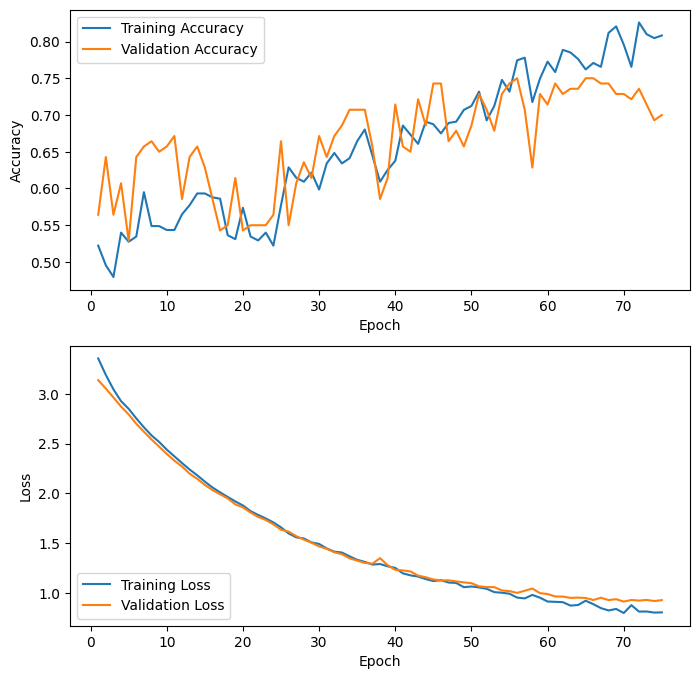

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v12 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V12.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V12_fitted = HCM_V12.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 200, 
    verbose=1,
    callbacks=[early_stopping, checkpoint_v12])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V12_fitted, model_name = model_name) 

5/5 [==============================] - 3s 539ms/step
True Negatives:  42
False Positives:  22
False Negatives:  13
True Positives:  63
Total Positive Images:  76


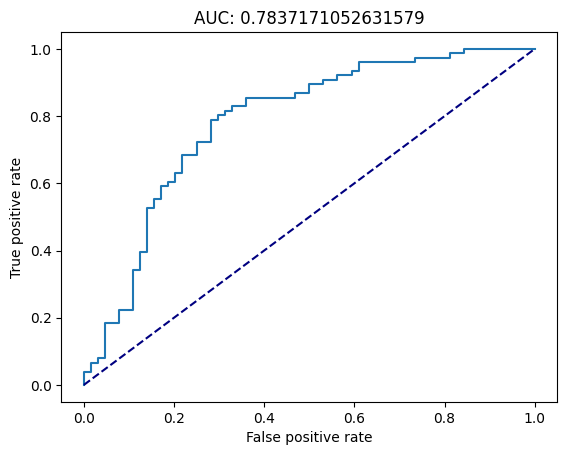

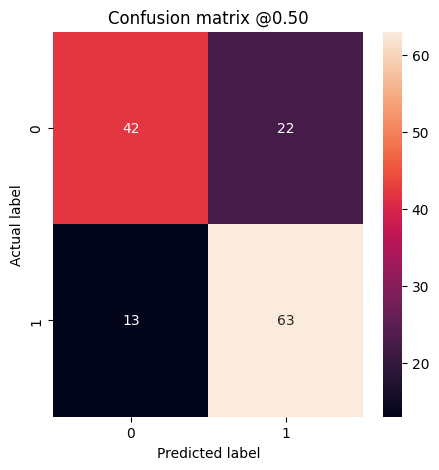

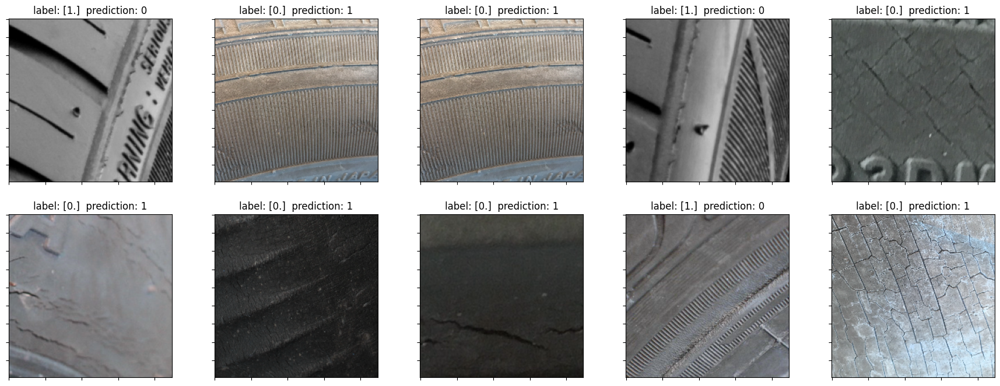

In [ ]:
HCM_V12.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V12, ds_val)

#Plot curves with data from google_drive:
#plot_curves(model_fit = None, model_name = model_name)

Incorporating the discussed modifications and extending the number of training epochs, our model achieved a validation score of 0.75. However, the pronounced volatility observed in the validation accuracy suggests that the model continues to overfit the training data. To further enhance performance and address overfitting, additional refinements and experimentation with alternative techniques are required in the next iterations.

### 3.4.13 Handcrafted Model Vers_13

In an effort to further mitigate overfitting in the next model iteration, we propose the following changes:

- Increasing ``dropout`` to 0.35: A higher dropout rate helps regularize the model by randomly dropping out a fraction of neurons during training, thereby preventing the model from relying too heavily on specific features or becoming overly complex. This can improve generalization and help prevent overfitting (See Srivastava et al., 2014)[6].

- Decreasing the number of ``filters`` in the convolutional layers:

1. First Layer: from 6 to 4
2. Second Layer: from 16 to 12
Reducing the number of filters in the convolutional layers results in a simpler model architecture, which can lessen the likelihood of overfitting. A more complex model has the potential to fit the noise in the training data instead of learning the underlying pattern, leading to poor performance on unseen data. By simplifying the architecture, we aim to improve the model's generalization capabilities (Goodfellow et al., 2016)[1]

In [ ]:
model_name = "HCM_V13"

HCM_V13 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=4, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.2)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=12, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.2)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.he_normal()),
 
    Dropout(0.35),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.he_normal()),
   
    Dropout(0.35),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.he_normal()),
    
    Dropout(0.35),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V13.summary()

Model: "HCM_V13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d_2 (Conv2D)           (None, 220, 220, 4)       304       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 110, 110, 4)      0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 106, 106, 12)      1212      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 53, 53, 12)       0         
 2D)                                                             
                                                           

Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 2.4975 - accuracy: 0.4760
Epoch 1: val_accuracy improved from -inf to 0.45714, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V13.h5
18/18 [==============================] - 18s 524ms/step - loss: 2.4975 - accuracy: 0.4760 - val_loss: 2.4498 - val_accuracy: 0.4571
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 2.4258 - accuracy: 0.5080
Epoch 2: val_accuracy improved from 0.45714 to 0.58571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V13.h5
18/18 [==============================] - 14s 536ms/step - loss: 2.4258 - accuracy: 0.5080 - val_loss: 2.3858 - val_accuracy: 0.5857
Epoch 3/50
16/18 [=========================>....] - ETA: 0s - loss: 2.3608 - accuracy: 0.5488
Epoch 3: val_accuracy did not improve from 0.58571
18/18 [==============================] - 14s 571ms/step - loss: 2.3579 - accur

,Epoch,accuracy,val_accuracy,accuracy_difference
37,38,0.934281,0.671429,0.26
38,39,0.944938,0.692857,0.25
39,40,0.941385,0.700000,0.24
40,41,0.957371,0.692857,0.26
41,42,0.952043,0.685714,0.27


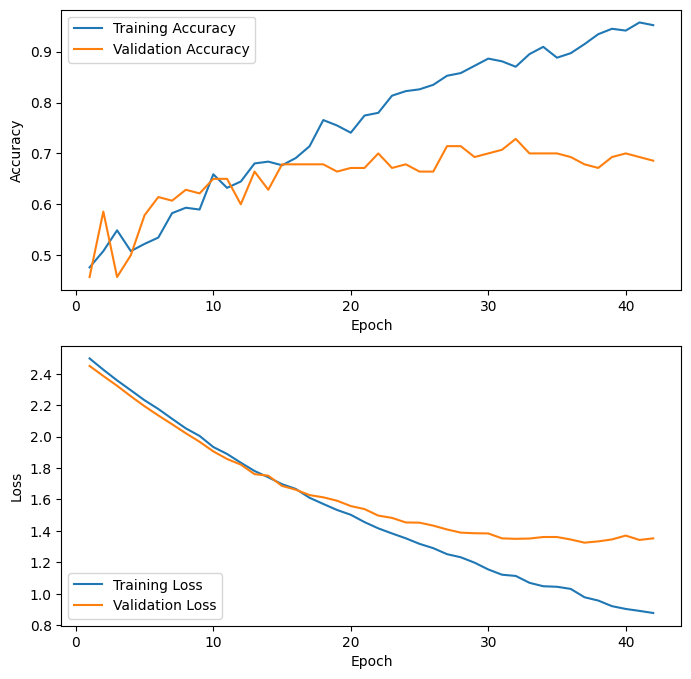

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v13 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V13.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V13_fitted = HCM_V13.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50, 
    verbose=1,
    callbacks=[early_stopping, checkpoint_v13])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V13_fitted, model_name = model_name) 

5/5 [==============================] - 5s 889ms/step
True Negatives:  41
False Positives:  23
False Negatives:  15
True Positives:  61
Total Positive Images:  76


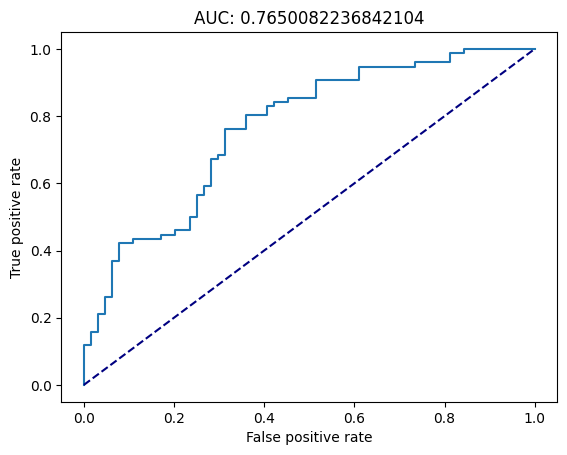

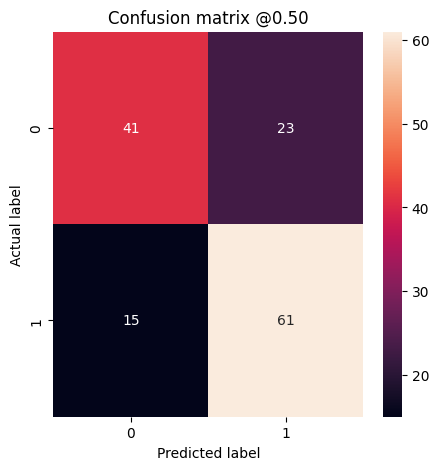

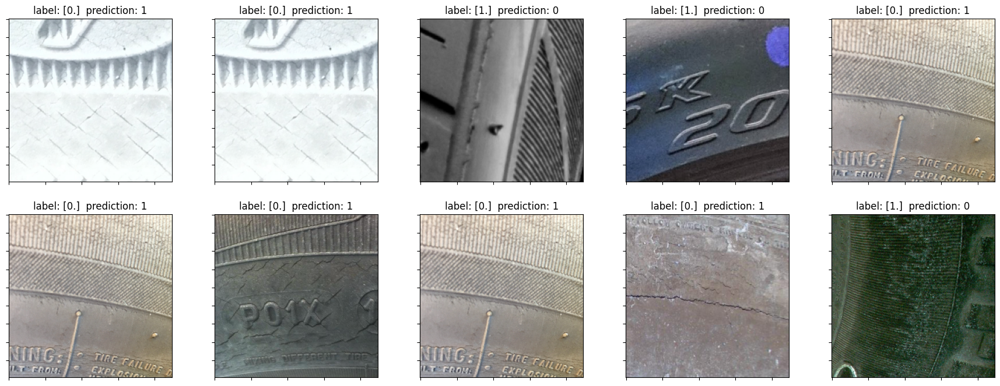

In [ ]:
HCM_V13.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V13, ds_val)

The observed outcome of the model, which showed increased overfitting and more false positive as well as false negative values, can be attributed to the following reasons:

- **Over-simplifying the model** architecture by decreasing the number of filters might have made the model less capable of capturing important features in the validation set, resulting in reduced generalization ability (Goodfellow et al., 2016)[1]

- The increased dropout rate could have led to **excessive neuron dropout**, hindering the model's ability to learn critical patterns in the data (See Srivastava et al., 2014)[6]

As a result we will not proceed with this model anymore and  go back a few steps to ``Vers_10``. 

### 3.4.14 Handcrafted Model Vers_14

In order to address these issues and improve the model's performance, we propose the following changes for the next iteration:

1. Revert to the architecture version 10, which displayed less overfitting and a relatively high validation accuracy of 0.73.

2. Add one more fully connected layer to the architecture, which can help in optimizing the classification space of the CNN. An additional fully connected layer may enable the model to capture more complex and abstract representations, leading to improved classification performance (See LeCun et al.,1998)[8]



In [ ]:
model_name = "HCM_V14"

HCM_V14 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=12, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    Dropout(0.6),

    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    Dropout(0.6),

    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    Dropout(0.6),

    layers.Dense(units=32, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),

    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V14.summary()

Model: "HCM_V14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 12)      912       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 12)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      4816      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                           

Epoch 1/50
16/18 [=========================>....] - ETA: 0s - loss: 1.8988 - accuracy: 0.5117
Epoch 1: val_accuracy improved from -inf to 0.48571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V14.h5
18/18 [==============================] - 19s 599ms/step - loss: 1.8926 - accuracy: 0.5115 - val_loss: 1.7601 - val_accuracy: 0.4857
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 1.7819 - accuracy: 0.4902
Epoch 2: val_accuracy improved from 0.48571 to 0.62143, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V14.h5
18/18 [==============================] - 16s 553ms/step - loss: 1.7819 - accuracy: 0.4902 - val_loss: 1.7184 - val_accuracy: 0.6214
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 1.7110 - accuracy: 0.5009
Epoch 3: val_accuracy did not improve from 0.62143
18/18 [==============================] - 13s 512ms/step - loss: 1.7110 - accur

,Epoch,accuracy,val_accuracy,accuracy_difference
45,46,0.637655,0.664286,-0.03
46,47,0.630551,0.707143,-0.08
47,48,0.623446,0.700000,-0.08
48,49,0.634103,0.700000,-0.07
49,50,0.634103,0.692857,-0.06


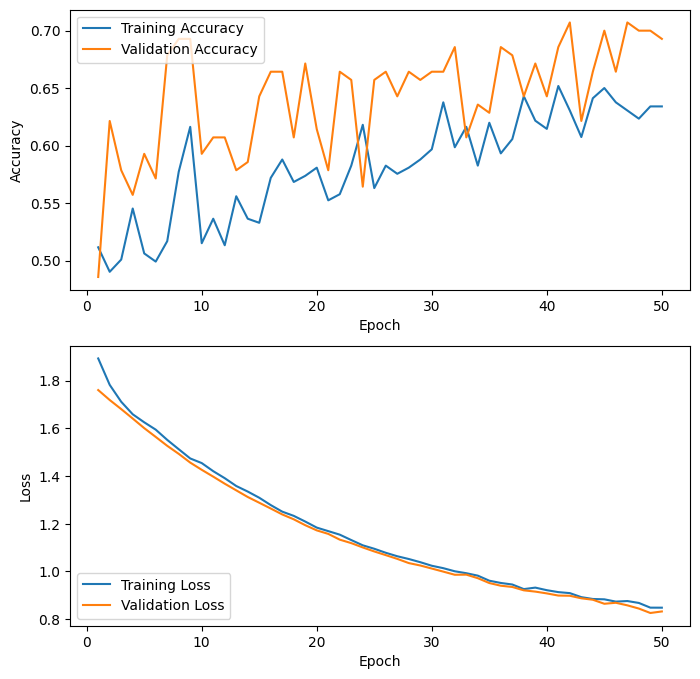

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v14 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V14.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V14_fitted = HCM_V14.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50, 
    verbose=1,
    callbacks=[early_stopping, checkpoint_v14])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V14_fitted, model_name = model_name) 

5/5 [==============================] - 4s 782ms/step
True Negatives:  32
False Positives:  32
False Negatives:  9
True Positives:  67
Total Positive Images:  76


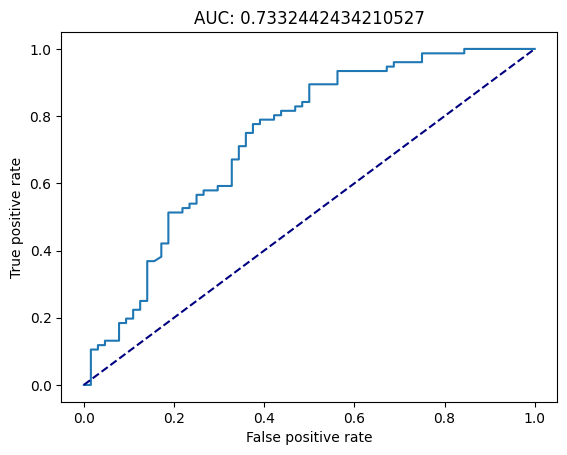

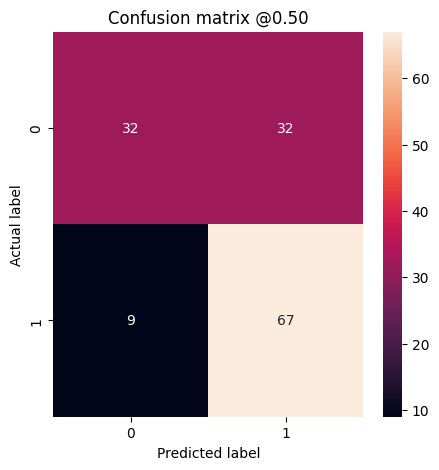

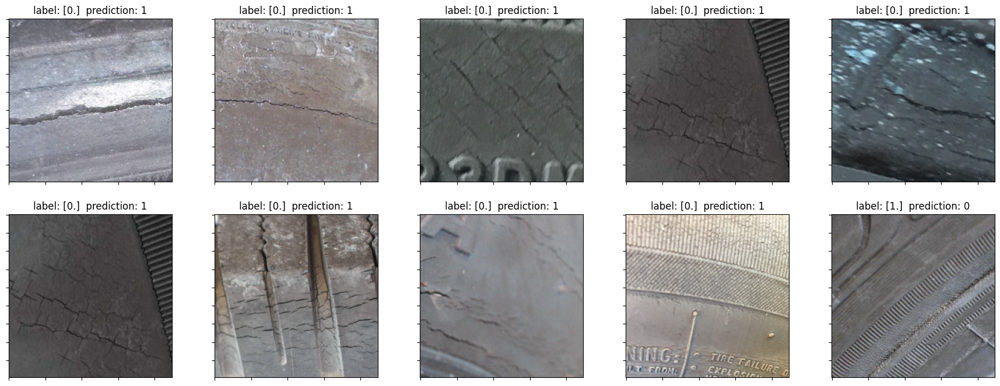

In [ ]:
HCM_V14.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')
viz_trial_results(HCM_V14, ds_val)

The learning curves show us that the model is constantly producing a better performance on the validation accuracy than on the training accuracy.

A model producing better performance on the validation accuracy than on the training accuracy is an unusual phenomenon, and it could be attributed to a few possible factors:

- Regularization: The presence of strong regularization techniques, such as dropout, L1, or L2 regularization, may have imposed constraints on the model that prevent it from fitting too closely to the training data. In certain cases, this could lead to a better validation accuracy than training accuracy (Goodfellow et al., 2016)[1]

- Data representation: Another possibility is that the validation set is not representative of the training set's underlying data distribution, leading to differing performance metrics. The validation set might have samples that are, by chance, easier for the model to classify, resulting in better validation accuracy (Goodfellow et al., 2016)[1]


At this point, it does not seem sensible to us to continue working at this point and we cancel this approach. We will introduce other measures in the next step. 

### 3.4.1.5 Handcrafted Model Vers_15

In an attempt to address the observed discrepancies between training and validation accuracy in the previous model, we will simplify the architecture and make several adjustments. The rationale behind these changes is as follows:

1. **Reducing the fully connected dense layers**: By reducing the number of fully connected dense layers to two layers with 50 and 16 units, we aim to decrease the model's complexity and capacity. This could help mitigate overfitting and improve generalization (Goodfellow et al., 2016)[1]. Furthermore, reducing the number of layers could also decrease the training time and computational resources required (See Bengio et al., 2012)[12]

2. **Increasing the kernel regularizers**: Increasing the value of the kernel-regularizers to 0.2 will apply stronger regularization to the model's weights, thus constraining the model and reducing overfitting. Regularization is a key technique to improve generalization and prevent overfitting in deep learning models (Goodfellow et al., 2016)[1]

3. **Reducing the dropout values**: By reducing the dropout values to 0.5, we aim to find a balance between the model's capacity and its ability to generalize (See Srivastava et al., 2014)[6]. However, applying too much dropout may lead to underfitting, while too little may lead to overfitting, so it is important to find an appropriate value for the dropout rate.

By implementing these adjustments, we hope to create a more balanced and less complex architecture that better generalizes to unseen data and reduces the discrepancies between training and validation accuracy.

In [ ]:
model_name = "HCM_V15"

HCM_V15 = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.2)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.2)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),

    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=50, activation='relu', kernel_initializer=initializers.he_normal()),
    Dropout(0.5),
    layers.Dense(units=16, activation='relu', kernel_initializer=initializers.he_normal()),
    Dropout(0.5),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)

HCM_V15.summary()

Model: "HCM_V15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d_4 (Conv2D)           (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 110, 110, 6)      0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                           

Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 3.2089 - accuracy: 0.5133
Epoch 1: val_accuracy improved from -inf to 0.58571, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V15.h5
18/18 [==============================] - 73s 2s/step - loss: 3.2089 - accuracy: 0.5133 - val_loss: 3.1327 - val_accuracy: 0.5857
Epoch 2/50
16/18 [=========================>....] - ETA: 0s - loss: 3.0847 - accuracy: 0.5586
Epoch 2: val_accuracy did not improve from 0.58571
18/18 [==============================] - 13s 492ms/step - loss: 3.0808 - accuracy: 0.5577 - val_loss: 3.0241 - val_accuracy: 0.4571
Epoch 3/50
16/18 [=========================>....] - ETA: 0s - loss: 2.9897 - accuracy: 0.5410
Epoch 3: val_accuracy improved from 0.58571 to 0.61429, saving model to /content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/student/HCM_V15.h5
18/18 [==============================] - 13s 536ms/step - loss: 2.9833 - accuracy

,Epoch,accuracy,val_accuracy,accuracy_difference
45,46,0.710480,0.714286,-0.00
46,47,0.698046,0.678571,0.02
47,48,0.685613,0.692857,-0.01
48,49,0.737123,0.700000,0.04
49,50,0.641208,0.657143,-0.02


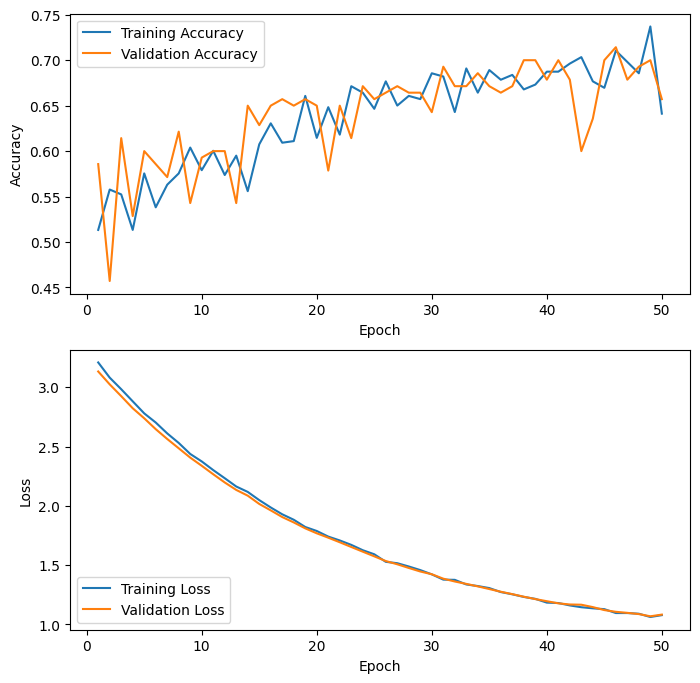

In [ ]:
#Clear Session
tf.keras.backend.clear_session()

#a new checkpoint needs to be defined, in order to save the best weights from this model, even though it might not be a global maximum
checkpoint_v15 = ModelCheckpoint(                                                                                                         #change here
    f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5',
    monitor='val_accuracy',
    save_best_only=True,
    save_weights_only=False,
    mode='max',
    verbose=1
)


# Compile Model
HCM_V15.compile(                                                                                                                             #Change here
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

# Fit Model
# Note: to increase efficiency the number of max epochs was reduced to 50
HCM_V15_fitted = HCM_V15.fit(                                                                                                                 #Change here
    ds_train,
    validation_data = ds_val,
    epochs = 50, 
    verbose=1,
    callbacks=[early_stopping, checkpoint_v15])                                                                                              #Change here

#Save and visualise the learning curves
plot_curves(model_fit = HCM_V15_fitted, model_name = model_name) 

#3.5 Evaluating the Baseline and Best Model on the Test Set

In the following the Training and the Validation Set get combined to one training set again. Next the model is fitted on the whole training data and evaluated on the test set. 

##3.5.1 Evaluating on the fitted model using the Training/Validation Split

In [ ]:
model_name = "LeNet-5_V1"
lenet_1.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')




lenet_1.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

lenet_1.evaluate(ds_test)

11/11 [==============================] - 14s 50ms/step - loss: 0.6969 - accuracy: 0.5164


[0.696915328502655, 0.516417920589447]

In [ ]:
model_name = "HCM_V10"

HCM_V10.load_weights(f'/content/drive/MyDrive/DeepLearningProject/03 Project/Handcrafted_le_net/{run_type}/{model_name}.h5')

HCM_V10.compile(
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

HCM_V10.evaluate(ds_test)

11/11 [==============================] - 10s 126ms/step - loss: 0.8915 - accuracy: 0.6507


[0.8915398716926575, 0.6507462859153748]

##3.5.2 Evaluating on the fitted model using the whole training data

### Baseline Model

In [ ]:
ds_combined = ds_train.concatenate(ds_val)
# shuffle the combined dataset
ds_combined = ds_combined.shuffle(buffer_size=10000, seed=123)

In [ ]:
model_name ="LeNet-5_V1_on_test"

lenet_1_on_test = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu'),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu'),
    layers.AveragePooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers
    layers.Dense(units=120, activation='relu'),
    layers.Dense(units=84, activation='relu'),
    # Output layer
    layers.Dense(1, activation="sigmoid")
    ], name=model_name)

lenet_1_on_test.summary()

Model: "LeNet-5_V1_on_test"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 6)       456       
                                                                 
 average_pooling2d (AverageP  (None, 110, 110, 6)      0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 53, 53, 16)       0         
 ePooling2D)                                                     
                                                

In [ ]:
early_stopping_full = EarlyStopping(
    monitor='accuracy',
    patience=5,
    verbose = 1,
    restore_best_weights=True)

In [ ]:
# Compile Model
lenet_1_on_test.compile(                                                                                                                             
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

HCM_leNet_full_training_hist = lenet_1_on_test.fit(                                                                                                                 
    ds_combined,
    epochs = 100, 
    verbose=1,
    callbacks=[early_stopping_full])   

lenet_1_on_test.evaluate(ds_test)

Epoch 1/100
23/23 [==============================] - 89s 49ms/step - loss: 0.7855 - accuracy: 0.5377
Epoch 2/100
23/23 [==============================] - 12s 29ms/step - loss: 0.6631 - accuracy: 0.5932
Epoch 3/100
23/23 [==============================] - 13s 25ms/step - loss: 0.6244 - accuracy: 0.6671
Epoch 4/100
23/23 [==============================] - 11s 29ms/step - loss: 0.5225 - accuracy: 0.7553
Epoch 5/100
23/23 [==============================] - 13s 27ms/step - loss: 0.4937 - accuracy: 0.7795
Epoch 6/100
23/23 [==============================] - 13s 26ms/step - loss: 0.4047 - accuracy: 0.8407
Epoch 7/100
23/23 [==============================] - 13s 25ms/step - loss: 0.3820 - accuracy: 0.8421
Epoch 8/100
23/23 [==============================] - 12s 25ms/step - loss: 0.3102 - accuracy: 0.8748
Epoch 9/100
23/23 [==============================] - 13s 27ms/step - loss: 0.2264 - accuracy: 0.9218
Epoch 10/100
23/23 [==============================] - 12s 27ms/step - loss: 0.1605 - accura

[1.8760592937469482, 0.6567164063453674]

When evaluating the baseline model trained on the entire training dataset, a test accuracy of ``0.6567`` was obtained. This result was expected to be lower than the previous maximum accuracy of ``0.6857`` achieved by the baseline model at epoch 3. Therefore, it can be concluded that the model's performance on the test data is, as expected, worse. The difference is ``0.029``.

### Best Model

In [ ]:
model_name = "HCM_V10_on_test"

HCM_V10_on_test = Sequential([
    # Input layer
    layers.Input(input_shape),
    # Normalization pipeline
    data_normalization,
    # 1. conv layer
    layers.Conv2D(filters=6, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # 2. conv layer
    layers.Conv2D(filters=16, kernel_size=(5, 5), activation='relu', kernel_regularizer=regularizers.l2(0.06)),
    layers.MaxPooling2D(pool_size=(2, 2)),
    # Flatten layer
    layers.Flatten(),
    # Fully connected layers with Batch Normalization and Dropout
    layers.Dense(units=120, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
 
    Dropout(0.6),
    layers.Dense(units=84, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
   
    Dropout(0.6),
    layers.Dense(units=64, activation='relu', kernel_initializer=initializers.GlorotNormal(seed=seed)),
    
    Dropout(0.6),
    # Output layer
    layers.Dense(1, activation="sigmoid")
], name=model_name)


HCM_V10_on_test.summary()

Model: "HCM_V10_on_test"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_pipeline (Seq  (None, 224, 224, 3)      0         
 uential)                                                        
                                                                 
 conv2d_2 (Conv2D)           (None, 220, 220, 6)       456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 6)      0         
 )                                                               
                                                                 
 conv2d_3 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 16)       0         
 2D)                                                             
                                                   

In [ ]:
# Compile Model
HCM_V10_on_test.compile(                                                                                                                             
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
    )

HCM_V10_full_training_hist = HCM_V10_on_test.fit(                                                                                                                 
    ds_combined,
    epochs = 100, 
    verbose=1,
    callbacks=[early_stopping_full])   

HCM_V10_on_test.evaluate(ds_test)

Epoch 1/100
23/23 [==============================] - 16s 30ms/step - loss: 1.5128 - accuracy: 0.4893
Epoch 2/100
23/23 [==============================] - 13s 25ms/step - loss: 1.4305 - accuracy: 0.4751
Epoch 3/100
23/23 [==============================] - 12s 26ms/step - loss: 1.3798 - accuracy: 0.5092
Epoch 4/100
23/23 [==============================] - 14s 26ms/step - loss: 1.3495 - accuracy: 0.4922
Epoch 5/100
23/23 [==============================] - 11s 27ms/step - loss: 1.3183 - accuracy: 0.5505
Epoch 6/100
23/23 [==============================] - 13s 26ms/step - loss: 1.2859 - accuracy: 0.5377
Epoch 7/100
23/23 [==============================] - 13s 27ms/step - loss: 1.2599 - accuracy: 0.5661
Epoch 8/100
23/23 [==============================] - 13s 27ms/step - loss: 1.2363 - accuracy: 0.5434
Epoch 9/100
23/23 [==============================] - 12s 29ms/step - loss: 1.2117 - accuracy: 0.5405
Epoch 10/100
23/23 [==============================] - 12s 27ms/step - loss: 1.1872 - accura

[0.8072985410690308, 0.641791045665741]

When evaluating the best model trained on the entire training dataset, a test accuracy of ``0.6418`` was obtained (with early stopping). This result was expected to be lower than the previous maximum validation accuracy of ``0.7286`` achieved by the baseline model at epoch 49. Therefore, it can be concluded that the model's performance on the test data is, as expected, worse.
The difference is ``0.0868``